# ITADAKI - Recipe Image Retrieval (avec Transfer Learning)
## EfficientNet (gelé) + tête personnalisée (custom head avec couches denses) pour retrouver les top-3 recettes similaires à partir d'une image

**Objectif**: 
- Tester l'extraction d'embedding et la recherche par similarité avec EfficientNet gelé + transfer learning

**Bloc C5**:
- C1 : Préparer des données non structurées en les convertissant en données numériques et sous forme tabulaires pour servir de données d'entraînement à un algorithme d’apprentissage profond.
- C2 : Sélectionner l’algorithme d’apprentissage profond le plus adapté en comparant les performances et les caractéristiques des différentes familles d’algorithmes afin d'apporter une réponse pertinente adaptée à la problématique métier rencontrée.
- C3 : Entraîner un modèle d'apprentissage profond en optimisant une loss function (fonction de coût) à partir des données d’entraînement afin de permettre à l’algorithme d’effectuer le moins d’erreurs possibles selon des indicateurs de succès clairement définis.
- C4 : Déployer efficacement un modèle d'apprentissage profond en utilisant des outils et plateformes de production adaptés (MLOps), pour assurer une accessibilité et une performance optimale des prédictions de l'algorithme aux utilisateurs finaux.

---


## 1. Imports et configuration

In [1]:
import tensorflow as tf
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.applications.efficientnet import preprocess_input
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import os
import random
from PIL import Image
import re
from collections import Counter
from sklearn.model_selection import train_test_split
from sklearn.metrics.pairwise import cosine_similarity
import warnings
warnings.filterwarnings('ignore')

# Style dark theme
plt.style.use('dark_background')
sns.set_palette("husl")

# Seeds pour reproductibilité
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)

# HYPERPARAMETERS - Recipe Image Retrieval avec EfficientNet
CONFIG = {
    # === IMAGE PARAMETERS ===
    'IMG_SIZE': 224,                    # Optimal pour EfficientNet
    'BATCH_SIZE': 32,                   # Bon équilibre mémoire/performance
    
    # === EMBEDDING PARAMETERS ===
    'EMBEDDING_DIM_NATIVE': 1280,       # EfficientNet features natives
    'EMBEDDING_DIM_CUSTOM': 512,        # Custom head output (si fine-tuning)
    
    # === PHASE 1: FEATURE EXTRACTION ===
    'USE_NATIVE_FEATURES': True,        # True = 1280-dim, False = 512-dim custom
    
    # === PHASE 2: TRANSFER LEARNING ===
    'TRANSFER_EPOCHS': 15,              # Entraînement head seulement
    'TRANSFER_LR': 0.001,               # Learning rate plus élevé pour nouvelles couches
    'TRANSFER_BATCH_SIZE': 32,          # Plus petit pour stabilité
    
    # === PHASE 3: FINE-TUNING ===
    'FINETUNE_EPOCHS': 20,              # Fine-tuning complet
    'FINETUNE_LR': 0.0001,              # Learning rate faible pour pré-entraîné
    'FINETUNE_UNFREEZE_LAYERS': 20,     # Nombre de couches à dégeler
    
    # === TRAINING PARAMETERS ===
    'TRIPLET_MARGIN': 0.3,              # Augmenté pour meilleure séparation
    'DROPOUT_RATE': 0.3,                # Régularisation
    'WEIGHT_DECAY': 0.0001,             # L2 regularization
    
    # === OPTIMIZATION ===
    'OPTIMIZER': 'adam',                # Standard
    'PATIENCE': 5,                      # Early stopping
    'REDUCE_LR_PATIENCE': 3,            # Réduction LR
    'REDUCE_LR_FACTOR': 0.5,            # Facteur réduction
    
    # === DATA AUGMENTATION ===
    'USE_AUGMENTATION': True,           # Pour fine-tuning
    'ROTATION_RANGE': 15,               # Rotation aléatoire
    'ZOOM_RANGE': 0.1,                  # Zoom aléatoire
    'HORIZONTAL_FLIP': True,            # Flip horizontal
    
    # === EVALUATION ===
    'SIMILARITY_THRESHOLD': 0.7,       # Seuil similarité
    'TOP_K_RESULTS': 3,                 # Nombre résultats retournés
    'VALIDATION_SPLIT': 0.2,           # Split pour validation
}

# HYPERPARAMÈTRES Transfer Learning
CONFIG_TL = {
    # === IMAGE PARAMETERS ===
    'IMG_SIZE': 224,                    # Optimal pour EfficientNet
    'BATCH_SIZE': 32,                   # Bon équilibre mémoire/performance
    
    # === EMBEDDING PARAMETERS ===
    'EMBEDDING_DIM_NATIVE': 1280,       # EfficientNet features natives
    'EMBEDDING_DIM_CUSTOM': 512,        # Custom head output
    
    # === TRANSFER LEARNING (TRIPLET) ===
    'TRANSFER_EPOCHS': 15,              # Entraînement avec triplet loss
    'TRANSFER_LR': 0.001,               # Learning rate pour nouvelles couches
    'TRIPLET_MARGIN': 0.3,              # Marge triplet loss
    'DROPOUT_RATE': 0.3,                # Régularisation
    'WEIGHT_DECAY': 0.0001,             # L2 regularization
    
    # === OPTIMIZATION AVANCÉE ===
    'OPTIMIZER': 'adam',                # Standard
    'PATIENCE': 3,                      # Early stopping
    'REDUCE_LR_PATIENCE': 2,            # Réduction LR
    'REDUCE_LR_FACTOR': 0.5,            # Facteur réduction
    'MIN_LR': 1e-7,                     # LR minimum
    
    # === DATA AUGMENTATION ===
    'USE_AUGMENTATION': True,           # Augmentation
    'ROTATION_RANGE': 15,               # Rotation aléatoire
    'ZOOM_RANGE': 0.1,                  # Zoom aléatoire
    'BRIGHTNESS_RANGE': [0.9, 1.1],     # Luminosité
    'HORIZONTAL_FLIP': True,            # Flip horizontal
    
    # === VALIDATION & ÉVALUATION ===
    'VALIDATION_SPLIT': 0.2,           # Split pour validation
    'TOP_K_RESULTS': 3,                 # Nombre résultats
    'MIN_IMAGES_PER_RECIPE': 1,         # Filtrage minimum
    'MAX_PAIRS_PER_RECIPE': 5,          # Limite paires par recette
    
    # === MODÈLE ===
    'MODEL_NAME': 'recipe_image_retrieval_model_tl.keras',
    'EMBEDDINGS_NAME': 'recipe_embeddings_database_tl.npy',
    'METADATA_NAME': 'recipe_embeddings_database_metadata_tl.pkl'
}

print("Configuration adaptée pour EfficientNet Transfer Learning")
print(f"Phase 2: Transfer learning ({CONFIG['EMBEDDING_DIM_CUSTOM']}-dim, {CONFIG['TRANSFER_EPOCHS']} epochs)")

print("Imports et configuration OK!")
print(f"TensorFlow: {tf.__version__}")
print(f"GPU: {tf.config.list_physical_devices('GPU')}")


2025-07-14 12:06:43.510784: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-07-14 12:06:43.538205: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1752494803.563748   36629 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1752494803.575566   36629 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1752494803.594816   36629 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking 

Configuration adaptée pour EfficientNet Transfer Learning
Phase 2: Transfer learning (512-dim, 15 epochs)
Imports et configuration OK!
TensorFlow: 2.19.0
GPU: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


## 2. Définition du modèle Transfer Learning EfficientNetB0 + Custom Head

In [2]:
#  TRANSFER LEARNING - Triplet Loss + EfficientNetB0
# ================================================================================
#  Triplet Loss (meilleur que Contrastive)
#  Architecture robuste + gestion d'erreurs  
#  Hyperparamètres avancés (weight decay, reduce LR, validation)
#  Callbacks pour l'entraînement

import os
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import tensorflow as tf
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout, Layer
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint, TensorBoard
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.efficientnet import preprocess_input
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.model_selection import train_test_split
import time
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

print(f"Configuration Transfer Learning:")
print(f"- Taille des images: {CONFIG_TL['IMG_SIZE']}x{CONFIG_TL['IMG_SIZE']}")
print(f"- Taille du batch : {CONFIG_TL['BATCH_SIZE']}")
print(f"- Max Epochs: {CONFIG_TL['TRANSFER_EPOCHS']}")
print(f"- Embedding Dim: {CONFIG_TL['EMBEDDING_DIM_CUSTOM']} (custom)")
print(f"- Learning Rate: {CONFIG_TL['TRANSFER_LR']}")
print(f"- Triplet Margin: {CONFIG_TL['TRIPLET_MARGIN']}")
print(f"- Dropout Rate: {CONFIG_TL['DROPOUT_RATE']}")
print(f"- Weight Decay: {CONFIG_TL['WEIGHT_DECAY']}")
print(f"- Early Stopping: {CONFIG_TL['PATIENCE']} epochs")

# PREPROCESSING
def preprocess_image(image_path, img_size=224):
    """Preprocessing robuste avec gestion d'erreurs complète + preprocessing natif EfficientNet"""
    try:
        if not os.path.exists(image_path):
            return None
        
        # Vérifier la taille du fichier (éviter fichiers corrompus)
        if os.path.getsize(image_path) < 1024:  # Moins de 1KB
            return None
        
        img = Image.open(image_path)
        
        # Vérifier si l'image est valide
        img.verify()
        img = Image.open(image_path)
        
        # Convertir en RGB si nécessaire
        if img.mode != 'RGB':
            img = img.convert('RGB')
        
        # Redimensionner avec qualité optimale
        img = img.resize((img_size, img_size), Image.Resampling.LANCZOS)
        
        # Convertir en array et appliquer preprocessing EfficientNet
        img_array = np.array(img, dtype=np.float32)
        # Normalisation EfficientNet native
        img_array = preprocess_input(img_array)  
        
        return img_array
        
    except Exception as e:
        return None
    
# COUCHE L2 NORMALIZATION PERSONNALISÉE (SÉRIALISABLE)
class L2NormalizationLayer(Layer):
    """Couche personnalisée pour normalisation L2 - sérialisable"""
    
    def __init__(self, axis=1, **kwargs):
        super(L2NormalizationLayer, self).__init__(**kwargs)
        self.axis = axis
    
    def call(self, inputs):
        return tf.nn.l2_normalize(inputs, axis=self.axis)
    
    def compute_output_shape(self, input_shape):
        return input_shape
    
    def get_config(self):
        config = super(L2NormalizationLayer, self).get_config()
        config.update({'axis': self.axis})
        return config

# COUCHE EXTRACTION TRIPLET PERSONNALISÉE (SÉRIALISABLE)
class ExtractTripletComponent(Layer):
    """Couche pour extraire une composante du triplet"""
    
    def __init__(self, component_index, **kwargs):
        super(ExtractTripletComponent, self).__init__(**kwargs)
        self.component_index = component_index
    
    def call(self, inputs):
        return inputs[:, self.component_index]
    
    def compute_output_shape(self, input_shape):
        # input_shape = (batch_size, 3, height, width, channels)
        return (input_shape[0], input_shape[2], input_shape[3], input_shape[4])
    
    def get_config(self):
        config = super(ExtractTripletComponent, self).get_config()
        config.update({'component_index': self.component_index})
        return config

# COUCHE STACK TRIPLET PERSONNALISÉE (SÉRIALISABLE)
class TripletStackLayer(Layer):
    """Couche personnalisée pour empiler les embeddings triplet"""
    
    def __init__(self, **kwargs):
        super(TripletStackLayer, self).__init__(**kwargs)
    
    def call(self, inputs):
        # inputs = [anchor_emb, positive_emb, negative_emb]
        return tf.stack(inputs, axis=1)
    
    def compute_output_shape(self, input_shape):
        # input_shape = [(batch_size, embedding_dim), ...]
        batch_size = input_shape[0][0]
        embedding_dim = input_shape[0][1]
        return (batch_size, 3, embedding_dim)
    
    def get_config(self):
        return super(TripletStackLayer, self).get_config()

# ARCHITECTURE EMBEDDING
def create_embedding_model(input_shape=(224, 224, 3), embedding_dim=512):
    """Modèle d'embedding avec architecture optimisée pour triplet loss"""
    
    # EfficientNetB0 pré-entraîné (backbone gelé)
    base_model = EfficientNetB0(
        weights='imagenet',
        include_top=False,
        input_shape=input_shape
    )
    base_model.trainable = False  # Geler le backbone initialement

    # Pour du fine-tuning, on pourrait dégeler 20 dernières couches par exemple
    x = base_model.output

    # Custom head minimaliste
    x = base_model.output
    x = GlobalAveragePooling2D(name='global_avg_pool')(x)
    embeddings = Dense(embedding_dim, activation=None, name='embeddings')(x)

    # Normalisation L2 pour ce soit compatible avec triplet loss + similarité cosinus
    embeddings_normalized = L2NormalizationLayer(axis=1, name='l2_norm')(embeddings)
    # Modèle final
    model = Model(inputs=base_model.input, outputs=embeddings_normalized, name='TransferLearningEmbeddingModel')
    
    print(f"Modèle d'embedding créé:")
    print(f"- Params totaux: {model.count_params():,}")
    print(f"- Params entraînables: {sum([tf.size(w) for w in model.trainable_weights]):,}")
    print(f"- Architecture: EfficientNetB0 + Custom Head ({embedding_dim}D)")
    
    return model

# TRIPLET LOSS AVEC EMBEDDINGS NORMALISÉS
def triplet_loss(margin=0.3):
    """Triplet loss avec embeddings L2-normalisés"""
    def triplet_loss_fn(y_true, y_pred):
        """
        y_pred contient [anchor, positive, negative] embeddings normalisés
        Utilise distance cosinus (1 - similarity) pour la loss
        """
        anchor = y_pred[:, 0, :]      # (batch_size, embedding_dim)
        positive = y_pred[:, 1, :]    # (batch_size, embedding_dim)
        negative = y_pred[:, 2, :]    # (batch_size, embedding_dim)
        
        # Calcul des distances cosinus (1 - similarité cosinus)
        # Pour embeddings normalisés: cosine_sim = dot_product
        pos_similarity = tf.reduce_sum(anchor * positive, axis=1)
        neg_similarity = tf.reduce_sum(anchor * negative, axis=1)
        
        pos_distance = 1.0 - pos_similarity
        neg_distance = 1.0 - neg_similarity
        
        # Triplet loss: max(0, pos_dist - neg_dist + margin)
        basic_loss = pos_distance - neg_distance + margin
        loss = tf.maximum(0.0, basic_loss)
        
        return tf.reduce_mean(loss)
    
    return triplet_loss_fn

# visualisation des triplets
def show_triplets(generator, n_triplets=10, title=None):
    """Affiche n triplets (anchor, positive, negative) depuis un batch du générateur"""
    triplet_batch, _ = generator[0]
    
    # Votre générateur retourne un format (batch_size, 3, height, width, channels)
    # Donc triplet_batch.shape = (32, 3, 224, 224, 3)
    
    # Extraire les anchors, positives, negatives
    anchors = triplet_batch[:, 0, :, :, :]    # (batch_size, height, width, channels)
    positives = triplet_batch[:, 1, :, :, :]  # (batch_size, height, width, channels)
    negatives = triplet_batch[:, 2, :, :, :]  # (batch_size, height, width, channels)
    
    # Debug : afficher la vraie taille
    print(f"Taille réelle du batch : {len(anchors)}")
    
    # Prendre le minimum entre demandé et disponible
    n_triplets = min(n_triplets, len(anchors))

    def normalize_image(img):
        """Normalise l'image pour l'affichage"""
        if hasattr(img, 'numpy'):
            img = img.numpy()
        
        if len(img.shape) == 3 and img.shape[0] in [1, 3]:
            img = np.transpose(img, (1, 2, 0))
            if img.shape[2] == 1:
                img = img.squeeze(axis=2)
        
        if img.min() < 0:
            img = (img + 1.0) / 2.0
        elif img.max() > 1:
            img = img / 255.0
        
        return np.clip(img, 0, 1)

    plt.figure(figsize=(12, 4 * n_triplets))
    
    for i in range(n_triplets):
        for j, img in enumerate([anchors[i], positives[i], negatives[i]]):
            plt.subplot(n_triplets, 3, i * 3 + j + 1)
            
            normalized_img = normalize_image(img)
            plt.imshow(normalized_img, cmap='gray' if len(normalized_img.shape) == 2 else None)
            plt.axis('off')
            
            if j == 0:
                plt.title("Anchor")
            elif j == 1:
                plt.title("Positive")
            else:
                plt.title("Negative")
    
    if title:
        plt.suptitle(title, fontsize=16)
    
    plt.tight_layout()
    plt.show()

# GÉNÉRATEUR DE TRIPLETS
class TripletGenerator(tf.keras.utils.Sequence):
    """Générateur de triplets avec validation et augmentation avancée"""
    
    def __init__(self, recipes_df, batch_size=32, img_size=224, augment=True, validation_split=0.2, is_validation=False):
        self.batch_size = batch_size
        self.img_size = img_size
        self.augment = augment and not is_validation
        self.is_validation = is_validation
        
        # Filtrer et diviser les données
        self.valid_recipes = self._filter_valid_recipes(recipes_df)
        self.train_recipes, self.val_recipes = self._split_data(validation_split)
        
        # Utiliser le bon subset
        self.recipes_df = self.val_recipes if is_validation else self.train_recipes
        
        # Grouper par titre de recette
        self.recipe_groups = self.recipes_df.groupby('Title')
        self.recipe_names = list(self.recipe_groups.groups.keys())
        
        # Configuration augmentation de données
        if self.augment:
            self.datagen = ImageDataGenerator(
                rotation_range=CONFIG_TL['ROTATION_RANGE'],
                width_shift_range=0.1,
                height_shift_range=0.1,
                horizontal_flip=CONFIG_TL['HORIZONTAL_FLIP'],
                zoom_range=CONFIG_TL['ZOOM_RANGE'],
                brightness_range=CONFIG_TL['BRIGHTNESS_RANGE'],
                fill_mode='nearest'
            )
        
        self.on_epoch_end()
        
        split_name = "Validation" if is_validation else "Entraînement"
        print(f"Générateur {split_name} créé:")
        print(f"- Recettes: {len(self.recipe_names)}")
        print(f"- Images: {len(self.recipes_df)}")
        print(f"- Augmentation: {'Activée' if self.augment else 'Désactivée'}")
    
    def _filter_valid_recipes(self, recipes_df):
        """Filtrer les recettes avec images valides"""
        valid_recipes = []
        
        print("Filtrage des images valides...")
        for idx, row in tqdm(recipes_df.iterrows(), total=len(recipes_df), desc="Validation images"):
            if pd.notna(row['image_path']) and os.path.exists(row['image_path']):
                try:
                    img = Image.open(row['image_path'])
                    img.verify()
                    valid_recipes.append(row)
                except:
                    continue
        
        result_df = pd.DataFrame(valid_recipes)
        print(f"{len(result_df)}/{len(recipes_df)} images valides")
        return result_df
    
    def _split_data(self, validation_split):
        """Diviser les données en train/validation par recette"""
        unique_recipes = self.valid_recipes['Title'].unique()
        
        train_recipes, val_recipes = train_test_split(
            unique_recipes, 
            test_size=validation_split, 
            random_state=42
        )
        
        train_df = self.valid_recipes[self.valid_recipes['Title'].isin(train_recipes)]
        val_df = self.valid_recipes[self.valid_recipes['Title'].isin(val_recipes)]
        
        return train_df, val_df
    
    def __len__(self):
        return max(1, len(self.recipes_df) // self.batch_size)
    
    def __getitem__(self, index):
        return self._generate_triplet_batch()
    
    def on_epoch_end(self):
        """Mélanger les données à chaque époque"""
        pass
    
    def _generate_triplet_batch(self):
        """Générer un batch de triplets avec gestion robuste des erreurs"""
        batch_size = self.batch_size
        
        anchors = np.zeros((batch_size, self.img_size, self.img_size, 3), dtype=np.float32)
        positives = np.zeros((batch_size, self.img_size, self.img_size, 3), dtype=np.float32)
        negatives = np.zeros((batch_size, self.img_size, self.img_size, 3), dtype=np.float32)
        
        valid_triplets = 0
        attempts = 0
        # Plus de tentatives pour robustesse
        max_attempts = batch_size * 5 
        
        while valid_triplets < batch_size and attempts < max_attempts:
            attempts += 1
            
            try:
                # Sélectionner une recette positive (avec au moins 1 image)
                pos_recipe = np.random.choice(self.recipe_names)
                pos_group = self.recipe_groups.get_group(pos_recipe)
                
                # Sélectionner une recette négative différente
                available_neg_recipes = [r for r in self.recipe_names if r != pos_recipe]
                if not available_neg_recipes:
                    continue
                    
                neg_recipe = np.random.choice(available_neg_recipes)
                neg_group = self.recipe_groups.get_group(neg_recipe)
                
                # Sélectionner les images du triplet
                if len(pos_group) >= 2:
                    # Cas idéal: 2 images différentes de la même recette
                    anchor_row, pos_row = pos_group.sample(2).iloc
                else:
                    # Cas limite: même image pour anchor et positive
                    anchor_row = pos_row = pos_group.iloc[0]
                
                # Image négative d'une recette différente
                neg_row = neg_group.sample(1).iloc[0]
                
                # Charger et préprocesser les images
                anchor_img = preprocess_image(anchor_row['image_path'], self.img_size)
                pos_img = preprocess_image(pos_row['image_path'], self.img_size)
                neg_img = preprocess_image(neg_row['image_path'], self.img_size)
                
                # Vérifier que toutes les images sont valides
                if anchor_img is not None and pos_img is not None and neg_img is not None:
                    
                    # Appliquer l'augmentation de données
                    if self.augment:
                        # Pas d'augmentation sur anchor et negative
                        pos_img = self.datagen.random_transform(pos_img)
                       
                    
                    # Ajouter au batch
                    anchors[valid_triplets] = anchor_img
                    positives[valid_triplets] = pos_img
                    negatives[valid_triplets] = neg_img
                    
                    valid_triplets += 1
                    
            except Exception as e:
                print(f"Erreur sur un triplet: {e}")
                continue
        
        # Compléter avec des copies si nécessaire (cas rare)
        while valid_triplets < batch_size:
            print(f"Pas assez de triplets valides: {valid_triplets}")
            copy_idx = np.random.randint(0, max(1, valid_triplets))
            anchors[valid_triplets] = anchors[copy_idx]
            positives[valid_triplets] = positives[copy_idx]  
            negatives[valid_triplets] = negatives[copy_idx]
            valid_triplets += 1
        
        # Format pour le modèle triplet: (batch_size, 3, height, width, channels)
        triplet_batch = np.stack([anchors, positives, negatives], axis=1)
        dummy_labels = np.zeros((batch_size, 1))  # Non utilisé avec triplet loss
        
        return triplet_batch, dummy_labels

# MODÈLE TRIPLET POUR ENTRAÎNEMENT
def create_triplet_model(embedding_model):
   
    """Modèle triplet avec couches personnalisées sérialisables"""

    # Input: batch de triplets (batch_size, 3, height, width, channels)
    triplet_input = tf.keras.layers.Input(
        shape=(3, CONFIG_TL['IMG_SIZE'], CONFIG_TL['IMG_SIZE'], 3),
        name='triplet_input'
    )
    
    anchor = ExtractTripletComponent(0, name='extract_anchor')(triplet_input)
    positive = ExtractTripletComponent(1, name='extract_positive')(triplet_input)
    negative = ExtractTripletComponent(2, name='extract_negative')(triplet_input)
    
    # Obtenir les embeddings normalisés
    anchor_emb = embedding_model(anchor)
    positive_emb = embedding_model(positive)
    negative_emb = embedding_model(negative)
    
    triplet_output = TripletStackLayer(name='combine_embeddings')([anchor_emb, positive_emb, negative_emb])
    
    model = Model(inputs=triplet_input, outputs=triplet_output, name='TransferLearningTripletModel')
    
    print(f"Modèle triplet créé:")
    print(f"- Input shape: {model.input_shape}")
    print(f"- Output shape: {model.output_shape}")
    
    return model

# MÉTRIQUES
def triplet_accuracy(y_true, y_pred):
    """Précision: % de triplets où positive plus proche que negative"""
    anchor = y_pred[:, 0, :]     # (batch_size, embedding_dim)
    positive = y_pred[:, 1, :]   # (batch_size, embedding_dim)
    negative = y_pred[:, 2, :]   # (batch_size, embedding_dim)
    
    # Similarités cosinus (plus élevé = plus similaire)
    pos_similarity = tf.reduce_sum(anchor * positive, axis=1)
    neg_similarity = tf.reduce_sum(anchor * negative, axis=1)
    
    # Triplet correct si positive plus similaire que negative
    correct_triplets = tf.cast(pos_similarity > neg_similarity, tf.float32)
    accuracy = tf.reduce_mean(correct_triplets)
    
    return accuracy

def average_positive_similarity(y_true, y_pred):
    """Similarité moyenne anchor-positive"""
    anchor = y_pred[:, 0, :]
    positive = y_pred[:, 1, :]
    pos_similarity = tf.reduce_sum(anchor * positive, axis=1)
    return tf.reduce_mean(pos_similarity)

def average_negative_similarity(y_true, y_pred):
    """Similarité moyenne anchor-negative"""
    anchor = y_pred[:, 0, :]
    negative = y_pred[:, 2, :]
    neg_similarity = tf.reduce_sum(anchor * negative, axis=1)
    return tf.reduce_mean(neg_similarity)

# FONCTION D'ENTRAÎNEMENT PRINCIPALE
def train_transfer_learning():
    """Entraînement complet avec toutes les optimisations"""
    
    print("Début de l'entraînement Transfer Learning...")
    print("=" * 60)
    
    # Charger les données
    try:
        recipes_df = pd.read_pickle("./data/recipes_with_images_dataframe.pkl")
        print(f"{len(recipes_df)} recettes chargées depuis le DataFrame")
    except FileNotFoundError:
        print("Fichier ./data/recipes_with_images_dataframe.pkl introuvable")
        print("Assurez-vous d'avoir exécuté le notebook 'raw' qui génère le DataFrame sous forme de pickle")
        return None, None
    
    # Créer le modèle d'embedding
    print("\nCréation du modèle d'embedding...")
    embedding_model = create_embedding_model(
        input_shape=(CONFIG_TL['IMG_SIZE'], CONFIG_TL['IMG_SIZE'], 3),
        embedding_dim=CONFIG_TL['EMBEDDING_DIM_CUSTOM']
    )
    
    # Créer les générateurs de données (train + validation)
    print("\nCréation des générateurs de données...")
    train_generator = TripletGenerator(
        recipes_df,
        batch_size=CONFIG_TL['BATCH_SIZE'],
        img_size=CONFIG_TL['IMG_SIZE'],
        augment=CONFIG_TL['USE_AUGMENTATION'],
        validation_split=CONFIG_TL['VALIDATION_SPLIT'],
        is_validation=False
    )

    show_triplets(train_generator, n_triplets=10, title="Triplets train")
    
    val_generator = TripletGenerator(
        recipes_df,
        batch_size=CONFIG_TL['BATCH_SIZE'],
        img_size=CONFIG_TL['IMG_SIZE'],
        augment=False,  # Pas d'augmentation en validation
        validation_split=CONFIG_TL['VALIDATION_SPLIT'],
        is_validation=True
    )

    show_triplets(val_generator, n_triplets=10, title="Triplets val")
    
    # Créer le modèle triplet
    triplet_model = create_triplet_model(embedding_model)
    
    # Compiler le modèle avec optimisations
    triplet_model.compile(
        optimizer=Adam(
            learning_rate=CONFIG_TL['TRANSFER_LR'],
            weight_decay=CONFIG_TL['WEIGHT_DECAY']
        ),
        loss=triplet_loss(margin=CONFIG_TL['TRIPLET_MARGIN']),
        metrics=[triplet_accuracy, average_positive_similarity, average_negative_similarity]
    )
    
    print(f"Modèle compilé:")
    print(f"- Optimizer: Adam (lr={CONFIG_TL['TRANSFER_LR']}, wd={CONFIG_TL['WEIGHT_DECAY']})")
    print(f"- Loss: Triplet Loss (margin={CONFIG_TL['TRIPLET_MARGIN']})")
    print(f"- Métriques: Accuracy + Similarités moyenne")

    # CALLBACK PERSONNALISÉ pour sauvegarder UNIQUEMENT l'embedding model (et pas le triplet model)
    class EmbeddingModelCheckpoint(tf.keras.callbacks.Callback):
        """
        Callback personnalisé qui sauvegarde l'embedding model (pas le triplet model)
        C'est CRUCIAL car ModelCheckpoint standard sauvegarderait le triplet model !
        """
        def __init__(self, embedding_model, filepath, monitor='val_loss', save_best_only=True, verbose=1):
            super().__init__()
            self.embedding_model = embedding_model  # Le modèle qui nous intéresse
            self.filepath = filepath
            self.monitor = monitor
            self.save_best_only = save_best_only
            self.verbose = verbose
            self.best_value = np.inf if 'loss' in monitor else -np.inf
            
        def on_epoch_end(self, epoch, logs=None):
            current_value = logs.get(self.monitor)
            if current_value is None:
                if self.verbose > 0:
                    print(f"\n Métrique '{self.monitor}' non trouvée dans les logs")
                return
                
            improved = False
            if 'loss' in self.monitor or 'error' in self.monitor:
                # Pour les métriques à minimiser
                if current_value < self.best_value:
                    self.best_value = current_value
                    improved = True
            else:
                # Pour les métriques à maximiser (accuracy, etc.)
                if current_value > self.best_value:
                    self.best_value = current_value
                    improved = True
                    
            if improved or not self.save_best_only:
                try:
                    #  SAUVEGARDER L'EMBEDDING MODEL si amélioration (pas le triplet model)
                    if improved:
                        self.embedding_model.save(self.filepath)
                        print(f"\nNOUVEAU MEILLEUR MODELE D'EMBEDDINGS sauvegardé!")
                        print(f"Fichier: {self.filepath}")
                        print(f"{self.monitor}: {current_value:.4f}")
                    else:
                        print(f"\nPas d'amélioration du modèle d'embeddings")
                            
                except Exception as e:
                    if self.verbose > 0:
                        print(f"\nErreur sauvegarde embedding model: {e}")
                        
        def on_train_end(self, logs=None):
            if self.verbose > 0:
                print(f"\nEntraînement terminé. Meilleur {self.monitor}: {self.best_value:.4f}")
                print(f"Meilleur embedding model disponible: {self.filepath}")
    
    # Callbacks pour l'entraînement
    callbacks = [
        EarlyStopping(
            monitor='val_loss',
            patience=CONFIG_TL['PATIENCE'],
            restore_best_weights=True,
            verbose=1,
            mode='min'
        ),
        ReduceLROnPlateau(
            monitor='val_loss',
            patience=CONFIG_TL['REDUCE_LR_PATIENCE'],
            factor=CONFIG_TL['REDUCE_LR_FACTOR'],
            min_lr=CONFIG_TL['MIN_LR'],
            verbose=1,
            mode='min'
        ),
        ModelCheckpoint(
            f"./tl/best_triplet_{CONFIG_TL['MODEL_NAME']}",
            monitor='val_loss',
            save_best_only=True,
            save_weights_only=False,
            verbose=1,
            mode='min'
        ),
        EmbeddingModelCheckpoint(
            embedding_model,
            f"./tl/best_embedding_{CONFIG_TL['MODEL_NAME']}",
            monitor='val_loss',
            save_best_only=True,
            verbose=1,
        ),
        TensorBoard(
            log_dir=f"./tl/logs/{CONFIG_TL['MODEL_NAME']}",
            histogram_freq=1,
            write_graph=True,
            write_images=True,
            update_freq='epoch',
            profile_batch=2,
            embeddings_freq=1
        )
    ]
    
    print(f"Callbacks configurés:")
    print(f"- Early Stopping: patience={CONFIG_TL['PATIENCE']} (val_loss)")
    print(f"- Reduce LR: patience={CONFIG_TL['REDUCE_LR_PATIENCE']}, factor={CONFIG_TL['REDUCE_LR_FACTOR']}")
    print(f"- Model Checkpoint: best_{CONFIG_TL['MODEL_NAME']}")
    
    # Entraînement
    print("\n" + "="*60)
    print("DÉBUT DE L'ENTRAÎNEMENT")
    print("="*60)
    print(f"- Entraînement: {len(train_generator)} batch/époque")
    print(f"- Validation: {len(val_generator)} batch/époque")
    print(f"- Objectif: apprendre des embeddings discriminants via triplet loss")
    
    start_time = time.time()
    
    history = triplet_model.fit(
        train_generator,
        epochs=CONFIG_TL['TRANSFER_EPOCHS'],
        validation_data=val_generator,
        callbacks=callbacks,
        verbose=1
    )
    
    training_time = time.time() - start_time
    
    # Afficher les résultats
    print("\n" + "="*60)
    print(" ENTRAÎNEMENT TERMINÉ AVEC SUCCÈS!")
    print("="*60)
    print(f"⏱ Temps total: {training_time/60:.1f} minutes")
    print(f" Meilleure val_loss: {min(history.history['val_loss']):.4f}")
    print(f" Précision finale: {history.history['val_triplet_accuracy'][-1]:.4f}")
    print(f" Similarité pos finale: {history.history['val_average_positive_similarity'][-1]:.4f}")
    print(f" Similarité neg finale: {history.history['val_average_negative_similarity'][-1]:.4f}")
    print(f" Modèle sauvegardé: {CONFIG_TL['MODEL_NAME']}")
    
    return embedding_model, history

#  VISUALISATION DES RÉSULTATS
def plot_training_results(history):
    """Afficher les métriques d'entraînement avec échelles adaptées"""
    
    # Vérifier que les métriques existent
    required_metrics = ['loss', 'val_loss', 'triplet_accuracy', 'val_triplet_accuracy']
    for metric in required_metrics:
        if metric not in history.history:
            print(f"Métrique manquante: {metric}")
            return
    
    # Configuration dark mode (identique)
    plt.style.use('dark_background')
    colors = {
        'primary': '#00D4AA',
        'secondary': '#FF6B6B', 
        'accent': '#4ECDC4',
        'warning': '#FFE66D',
        'info': '#A8E6CF',
        'purple': '#B19CD9'
    }
    
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.patch.set_facecolor('#1e1e1e')
    fig.suptitle('Résultats d\'Entraînement Fine-Tuning', 
                 fontsize=18, fontweight='bold', color='white', y=0.95)
    
    for ax in axes.flat:
        ax.set_facecolor('#2d2d2d')
        ax.tick_params(colors='white', which='both')
        ax.xaxis.label.set_color('white')
        ax.yaxis.label.set_color('white')
        ax.title.set_color('white')
        ax.grid(True, alpha=0.2, color='gray', linestyle='-', linewidth=0.5)
        for spine in ax.spines.values():
            spine.set_color('white')
    
    # Loss
    axes[0, 0].plot(history.history['loss'], label='Train Loss', 
                    linewidth=3, color=colors['primary'], alpha=0.9)
    axes[0, 0].plot(history.history['val_loss'], label='Val Loss', 
                    linewidth=3, color=colors['secondary'], alpha=0.9)
    axes[0, 0].fill_between(range(len(history.history['loss'])), 
                           history.history['loss'], alpha=0.1, color=colors['primary'])
    axes[0, 0].fill_between(range(len(history.history['val_loss'])), 
                           history.history['val_loss'], alpha=0.1, color=colors['secondary'])
    axes[0, 0].set_title('Triplet Loss Evolution', fontweight='bold', fontsize=14)
    axes[0, 0].set_xlabel('Époque', fontweight='bold')
    axes[0, 0].set_ylabel('Loss Value', fontweight='bold')
    axes[0, 0].legend(frameon=True, fancybox=True, shadow=True, 
                     facecolor='#3d3d3d', edgecolor='white')
    
    # Accuracy
    axes[0, 1].plot(history.history['triplet_accuracy'], label='Train Accuracy', 
                    linewidth=3, color=colors['accent'], alpha=0.9)
    axes[0, 1].plot(history.history['val_triplet_accuracy'], label='Val Accuracy', 
                    linewidth=3, color=colors['warning'], alpha=0.9)
    axes[0, 1].axhline(y=0.8, color='white', linestyle='--', alpha=0.5, label='Target (80%)')
    axes[0, 1].set_title('Triplet Accuracy Progress', fontweight='bold', fontsize=14)
    axes[0, 1].set_xlabel('Époque', fontweight='bold')
    axes[0, 1].set_ylabel('Accuracy Score', fontweight='bold')
    axes[0, 1].legend(frameon=True, fancybox=True, shadow=True, 
                     facecolor='#3d3d3d', edgecolor='white')
    axes[0, 1].set_ylim(0, 1)  # ✅ Parfait
    
    # Positive Similarity
    if 'average_positive_similarity' in history.history:
        axes[1, 0].plot(history.history['average_positive_similarity'], label='Train Pos Sim', 
                        linewidth=3, color=colors['info'], alpha=0.9)
        axes[1, 0].plot(history.history['val_average_positive_similarity'], label='Val Pos Sim', 
                        linewidth=3, color=colors['purple'], alpha=0.9)
        
        
        axes[1, 0].set_ylim(0, 1)
        axes[1, 0].axhspan(0.7, 1.0, alpha=0.1, color='green', label='Target Zone (>0.7)')
        axes[1, 0].axhline(y=0.7, color='white', linestyle='--', alpha=0.5)
        
    axes[1, 0].set_title('Positive Similarity (Anchor-Positive)', fontweight='bold', fontsize=14)
    axes[1, 0].set_xlabel('Époque', fontweight='bold')
    axes[1, 0].set_ylabel('Cosine Similarity', fontweight='bold')
    axes[1, 0].legend(frameon=True, fancybox=True, shadow=True, 
                     facecolor='#3d3d3d', edgecolor='white')
    
    # Negative Similarity
    if 'average_negative_similarity' in history.history:
        axes[1, 1].plot(history.history['average_negative_similarity'], label='Train Neg Sim', 
                        linewidth=3, color=colors['secondary'], alpha=0.9)
        axes[1, 1].plot(history.history['val_average_negative_similarity'], label='Val Neg Sim', 
                        linewidth=3, color=colors['primary'], alpha=0.9)
        
        axes[1, 1].set_ylim(-0.5, 0.5) 
        axes[1, 1].axhspan(-0.5, 0.3, alpha=0.1, color='red', label='Target Zone (<0.3)')
        axes[1, 1].axhline(y=0.3, color='white', linestyle='--', alpha=0.5)
        
    axes[1, 1].set_title('Negative Similarity (Anchor-Negative)', fontweight='bold', fontsize=14)
    axes[1, 1].set_xlabel('Époque', fontweight='bold')
    axes[1, 1].set_ylabel('Cosine Similarity', fontweight='bold')
    axes[1, 1].legend(frameon=True, fancybox=True, shadow=True, 
                     facecolor='#3d3d3d', edgecolor='white')
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    plt.show()
    
    plt.style.use('default')
    
    # Résumé amélioré
    print("\nRÉSUMÉ DES MÉTRIQUES FINALES:")
    print("-" * 50)
    
    final_metrics = {}
    if 'val_loss' in history.history:
        final_metrics['Loss (validation)'] = history.history['val_loss'][-1]
    if 'val_triplet_accuracy' in history.history:
        final_metrics['Accuracy (validation)'] = history.history['val_triplet_accuracy'][-1]
    if 'val_average_positive_similarity' in history.history:
        final_metrics['Similarité Positive'] = history.history['val_average_positive_similarity'][-1]
    if 'val_average_negative_similarity' in history.history:
        final_metrics['Similarité Négative'] = history.history['val_average_negative_similarity'][-1]
    
    # Calcul de l'écart seulement si les deux métriques existent
    if 'val_average_positive_similarity' in history.history and 'val_average_negative_similarity' in history.history:
        final_metrics['Écart Pos-Neg'] = (history.history['val_average_positive_similarity'][-1] - 
                                          history.history['val_average_negative_similarity'][-1])
    
    for metric, value in final_metrics.items():
        print(f"{metric:25} : {value:.4f}")
    
    # Interprétation
    print("\nINTERPRÉTATION:")
    if 'val_triplet_accuracy' in history.history:
        acc = history.history['val_triplet_accuracy'][-1]
        if acc > 0.85:
            print(f"✅ Excellente accuracy ({acc:.1%})")
        elif acc > 0.75:
            print(f"🟡 Bonne accuracy ({acc:.1%})")
        else:
            print(f"❌ Accuracy faible ({acc:.1%}) - modèle à améliorer")

Configuration Transfer Learning:
- Taille des images: 224x224
- Taille du batch : 32
- Max Epochs: 15
- Embedding Dim: 512 (custom)
- Learning Rate: 0.001
- Triplet Margin: 0.3
- Dropout Rate: 0.3
- Weight Decay: 0.0001
- Early Stopping: 3 epochs


## 3. Entraînement du modèle

Début de l'entraînement Transfer Learning...
13463 recettes chargées depuis le DataFrame

Création du modèle d'embedding...


I0000 00:00:1752494808.082464   36629 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 17802 MB memory:  -> device: 0, name: NVIDIA L4, pci bus id: 0000:00:04.0, compute capability: 8.9


Modèle d'embedding créé:
- Params totaux: 4,705,443
- Params entraînables: 655,872
- Architecture: EfficientNetB0 + Custom Head (512D)

Création des générateurs de données...
Filtrage des images valides...


Validation images: 100%|██████████| 13463/13463 [00:03<00:00, 3569.23it/s]


13463/13463 images valides
Générateur Entraînement créé:
- Recettes: 10618
- Images: 10774
- Augmentation: Activée
Taille réelle du batch : 32


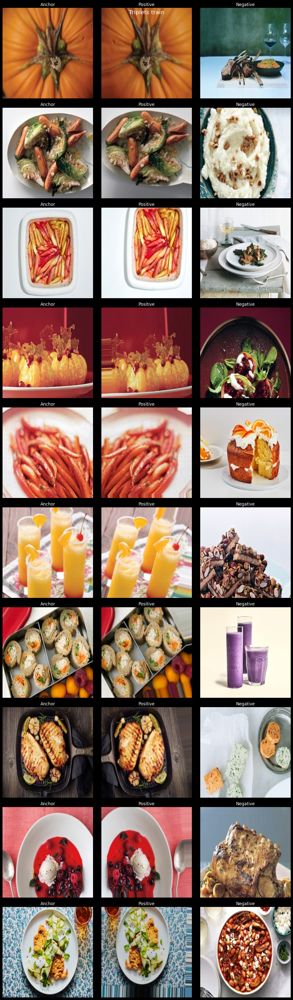

Filtrage des images valides...


Validation images: 100%|██████████| 13463/13463 [00:03<00:00, 3551.49it/s]


13463/13463 images valides
Générateur Validation créé:
- Recettes: 2655
- Images: 2689
- Augmentation: Désactivée
Taille réelle du batch : 32


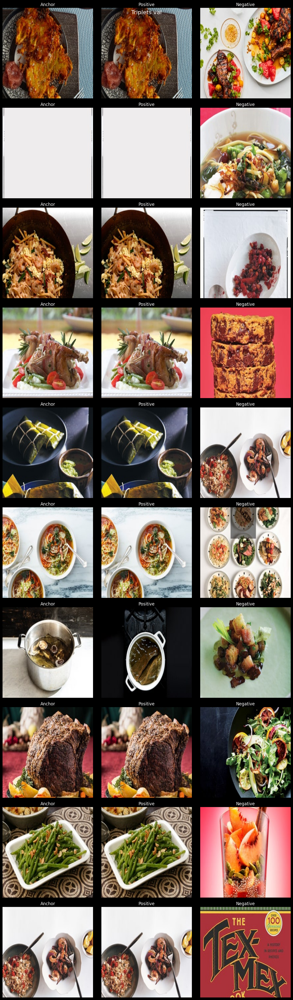

Modèle triplet créé:
- Input shape: (None, 3, 224, 224, 3)
- Output shape: (None, 3, 512)
Modèle compilé:
- Optimizer: Adam (lr=0.001, wd=0.0001)
- Loss: Triplet Loss (margin=0.3)
- Métriques: Accuracy + Similarités moyenne
Callbacks configurés:
- Early Stopping: patience=3 (val_loss)
- Reduce LR: patience=2, factor=0.5
- Model Checkpoint: best_recipe_image_retrieval_model_tl.keras

DÉBUT DE L'ENTRAÎNEMENT
- Entraînement: 336 batch/époque
- Validation: 84 batch/époque
- Objectif: apprendre des embeddings discriminants via triplet loss


2025-07-14 12:07:09.024487: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:103] Profiler session initializing.
2025-07-14 12:07:09.024512: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:118] Profiler session started.
I0000 00:00:1752494829.024535   36629 cupti_tracer.cc:1026] Profiler found 1 GPUs
W0000 00:00:1752494829.041576   36629 cupti_tracer.cc:1213] Fail to use per-thread activity buffer, cupti trace overhead may be big. CUPTI ERROR CODE:1
2025-07-14 12:07:09.041792: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:130] Profiler session tear down.
I0000 00:00:1752494829.041917   36629 cupti_tracer.cc:1249] CUPTI activity buffer flushed


Epoch 1/15


I0000 00:00:1752494861.723667   37150 service.cc:152] XLA service 0x7d0e3c002880 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1752494861.723732   37150 service.cc:160]   StreamExecutor device (0): NVIDIA L4, Compute Capability 8.9
2025-07-14 12:07:43.024627: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1752494868.628601   37150 cuda_dnn.cc:529] Loaded cuDNN version 90300


  1/336 ━━━━━━━━━━━━━━━━━━━━ 5:21:48 58s/step - average_negative_similarity: 0.2402 - average_positive_similarity: 0.8290 - loss: 0.0032 - triplet_accuracy: 1.0000

I0000 00:00:1752494889.362605   37150 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.
2025-07-14 12:08:09.522201: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:103] Profiler session initializing.
2025-07-14 12:08:09.522229: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:118] Profiler session started.
W0000 00:00:1752494889.532028   36629 cupti_tracer.cc:1213] Fail to use per-thread activity buffer, cupti trace overhead may be big. CUPTI ERROR CODE:1


  2/336 ━━━━━━━━━━━━━━━━━━━━ 1:15 226ms/step - average_negative_similarity: 0.2278 - average_positive_similarity: 0.8350 - loss: 0.0024 - triplet_accuracy: 1.0000 

2025-07-14 12:08:09.611404: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:68] Profiler session collecting data.
I0000 00:00:1752494889.663653   36629 cupti_tracer.cc:1249] CUPTI activity buffer flushed
I0000 00:00:1752494889.715407   36629 cupti_collector.cc:793]  GpuTracer has collected 694 callback api events and 693 activity events. 
I0000 00:00:1752494889.722715   36629 cupti_collector.cc:796]  GpuTracer max callback_events: 2097152, max activity events: 2097152
2025-07-14 12:08:09.733748: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:130] Profiler session tear down.
2025-07-14 12:08:09.736106: I external/local_xla/xla/tsl/profiler/rpc/client/save_profile.cc:147] Collecting XSpace to repository: ./tl/logs/recipe_image_retrieval_model_tl.keras/train/plugins/profile/2025_07_14_12_08_09/cs-01k049k9wca73f4x0bxzqk8ctj.xplane.pb


336/336 ━━━━━━━━━━━━━━━━━━━━ 0s 870ms/step - average_negative_similarity: 0.1147 - average_positive_similarity: 0.8420 - loss: 0.0019 - triplet_accuracy: 0.9984
Epoch 1: val_loss improved from inf to 0.00309, saving model to ./tl/best_triplet_recipe_image_retrieval_model_tl.keras

NOUVEAU MEILLEUR MODELE D'EMBEDDINGS sauvegardé!
Fichier: ./tl/best_embedding_recipe_image_retrieval_model_tl.keras
val_loss: 0.0031
336/336 ━━━━━━━━━━━━━━━━━━━━ 404s 1s/step - average_negative_similarity: 0.1147 - average_positive_similarity: 0.8420 - loss: 0.0019 - triplet_accuracy: 0.9984 - val_average_negative_similarity: 0.0613 - val_average_positive_similarity: 0.9891 - val_loss: 0.0031 - val_triplet_accuracy: 0.9955 - learning_rate: 0.0010
Epoch 2/15
336/336 ━━━━━━━━━━━━━━━━━━━━ 0s 916ms/step - average_negative_similarity: 0.0697 - average_positive_similarity: 0.8681 - loss: 0.0012 - triplet_accuracy: 0.9992
Epoch 2: val_loss did not improve from 0.00309
336/336 ━━━━━━━━━━━━━━━━━━━━ 350s 1s/step - aver

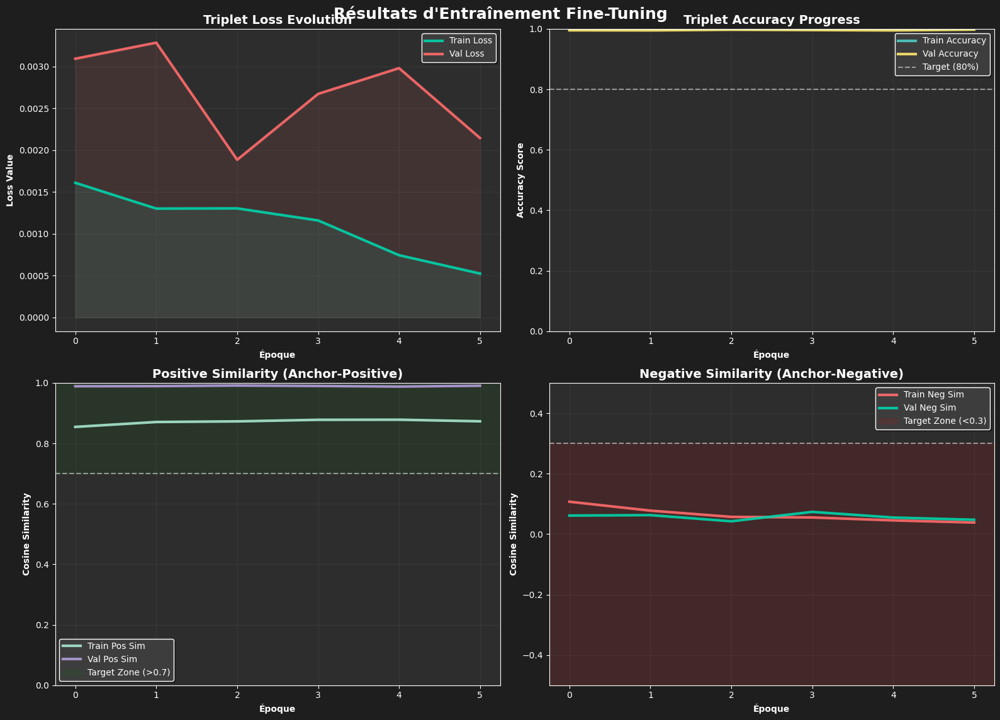


RÉSUMÉ DES MÉTRIQUES FINALES:
--------------------------------------------------
Loss (validation)         : 0.0021
Accuracy (validation)     : 0.9978
Similarité Positive       : 0.9908
Similarité Négative       : 0.0474
Écart Pos-Neg             : 0.9434

INTERPRÉTATION:
✅ Excellente accuracy (99.8%)

SUCCÈS! Entraînement terminé.
Modèle prêt: recipe_image_retrieval_model_tl.keras
Prêt pour l'extraction d'embeddings et la recherche par similarité!


In [3]:
# Entraîner le modèle
embedding_model, history = train_transfer_learning()

if embedding_model is not None and history is not None:
    # Afficher les résultats
    plot_training_results(history)
    
    print("\nSUCCÈS! Entraînement terminé.")
    print(f"Modèle prêt: {CONFIG_TL['MODEL_NAME']}")
    print("Prêt pour l'extraction d'embeddings et la recherche par similarité!")
    
else:
    print("Échec de l'entraînement. Vérifiez les données et ressayez.")

## 4. Création du système de recherche avec la classe RecipeImageRetrievalTL

In [4]:
# PREPROCESSING
def preprocess_image(image_path, img_size=224):
    """Preprocessing robuste avec gestion d'erreurs complète + EfficientNet optimisé"""
    try:
        if not os.path.exists(image_path):
            return None
        
        # Vérifier la taille du fichier (éviter fichiers corrompus)
        if os.path.getsize(image_path) < 1024:  # Moins de 1KB
            return None
        
        img = Image.open(image_path)
        
        # Vérifier si l'image est valide
        img.verify()
        img = Image.open(image_path)  # Recharger après verify
        
        # Convertir en RGB si nécessaire
        if img.mode != 'RGB':
            img = img.convert('RGB')
        
        # Redimensionner avec qualité optimale
        img = img.resize((img_size, img_size), Image.Resampling.LANCZOS)
        
        # Convertir en array et appliquer preprocessing EfficientNet
        img_array = np.array(img, dtype=np.float32)
        img_array = preprocess_input(img_array)  #  Normalisation EfficientNet native
        
        return img_array
        
    except Exception as e:
        return None

#  COUCHE L2 NORMALIZATION PERSONNALISÉE (SÉRIALISABLE)
class L2NormalizationLayer(Layer):
    """Couche personnalisée pour normalisation L2 - sérialisable"""
    
    def __init__(self, axis=1, **kwargs):
        super(L2NormalizationLayer, self).__init__(**kwargs)
        self.axis = axis
    
    def call(self, inputs):
        return tf.nn.l2_normalize(inputs, axis=self.axis)
    
    def compute_output_shape(self, input_shape):
        return input_shape
    
    def get_config(self):
        config = super(L2NormalizationLayer, self).get_config()
        config.update({'axis': self.axis})
        return config

#  COUCHE EXTRACTION TRIPLET PERSONNALISÉE (SÉRIALISABLE)
class ExtractTripletComponent(Layer):
    """Couche pour extraire une composante du triplet"""
    
    def __init__(self, component_index, **kwargs):
        super(ExtractTripletComponent, self).__init__(**kwargs)
        self.component_index = component_index
    
    def call(self, inputs):
        return inputs[:, self.component_index]
    
    def compute_output_shape(self, input_shape):
        # input_shape = (batch_size, 3, height, width, channels)
        return (input_shape[0], input_shape[2], input_shape[3], input_shape[4])
    
    def get_config(self):
        config = super(ExtractTripletComponent, self).get_config()
        config.update({'component_index': self.component_index})
        return config

#  COUCHE STACK TRIPLET PERSONNALISÉE (SÉRIALISABLE)
class TripletStackLayer(Layer):
    """Couche personnalisée pour empiler les embeddings triplet"""
    
    def __init__(self, **kwargs):
        super(TripletStackLayer, self).__init__(**kwargs)
    
    def call(self, inputs):
        # inputs = [anchor_emb, positive_emb, negative_emb]
        return tf.stack(inputs, axis=1)
    
    def compute_output_shape(self, input_shape):
        # input_shape = [(batch_size, embedding_dim), ...]
        batch_size = input_shape[0][0]
        embedding_dim = input_shape[0][1]
        return (batch_size, 3, embedding_dim)
    
    def get_config(self):
        return super(TripletStackLayer, self).get_config()

class RecipeImageRetrievalTL:
    """
    Version Transfer Learning de RecipeImageRetrievalTL
    Même fonctionnalités, mais avec le modèle TL entraîné
    """

    def __init__(self, model_path=None, recipes_df=None):
        #  Charger le modèle TL
        if model_path is None:
            model_path = './tl/best_embedding_recipe_image_retrieval_model_tl.keras'
        
        #  TRIPLET LOSS OPTIMISÉE POUR EMBEDDINGS NORMALISÉS
        def triplet_loss(margin=0.3):
            """Triplet loss optimisée pour embeddings L2-normalisés"""
            def triplet_loss_fn(y_true, y_pred):
                """
                y_pred contient [anchor, positive, negative] embeddings normalisés
                Utilise distance cosinus (1 - similarity) pour la loss
                """
                anchor = y_pred[:, 0, :]      # (batch_size, embedding_dim)
                positive = y_pred[:, 1, :]    # (batch_size, embedding_dim)
                negative = y_pred[:, 2, :]    # (batch_size, embedding_dim)
                
                # Calcul des distances cosinus (1 - similarité cosinus)
                # Pour embeddings normalisés: cosine_sim = dot_product
                pos_similarity = tf.reduce_sum(anchor * positive, axis=1)
                neg_similarity = tf.reduce_sum(anchor * negative, axis=1)
                
                pos_distance = 1.0 - pos_similarity
                neg_distance = 1.0 - neg_similarity
                
                # Triplet loss: max(0, pos_dist - neg_dist + margin)
                basic_loss = pos_distance - neg_distance + margin
                loss = tf.maximum(0.0, basic_loss)
                
                return tf.reduce_mean(loss)
            
            return triplet_loss_fn
        
        #  MÉTRIQUES
        def triplet_accuracy(y_true, y_pred):
            """Précision: % de triplets où positive plus proche que negative"""
            anchor = y_pred[:, 0, :]     # (batch_size, embedding_dim)
            positive = y_pred[:, 1, :]   # (batch_size, embedding_dim)
            negative = y_pred[:, 2, :]   # (batch_size, embedding_dim)
            
            # Similarités cosinus (plus élevé = plus similaire)
            pos_similarity = tf.reduce_sum(anchor * positive, axis=1)
            neg_similarity = tf.reduce_sum(anchor * negative, axis=1)
            
            # Triplet correct si positive plus similaire que negative
            correct_triplets = tf.cast(pos_similarity > neg_similarity, tf.float32)
            accuracy = tf.reduce_mean(correct_triplets)
            
            return accuracy

        def average_positive_similarity(y_true, y_pred):
            """Similarité moyenne anchor-positive"""
            anchor = y_pred[:, 0, :]
            positive = y_pred[:, 1, :]
            pos_similarity = tf.reduce_sum(anchor * positive, axis=1)
            return tf.reduce_mean(pos_similarity)

        def average_negative_similarity(y_true, y_pred):
            """Similarité moyenne anchor-negative"""
            anchor = y_pred[:, 0, :]
            negative = y_pred[:, 2, :]
            neg_similarity = tf.reduce_sum(anchor * negative, axis=1)
            return tf.reduce_mean(neg_similarity)
        
        # Custom objects pour charger correctement le modèle
        custom_objects = {
            'L2NormalizationLayer': L2NormalizationLayer,
            'ExtractTripletComponent': ExtractTripletComponent,
            'TripletStackLayer': TripletStackLayer,
            'triplet_loss': triplet_loss(),
            'triplet_accuracy': triplet_accuracy,
            'average_positive_similarity': average_positive_similarity,
            'average_negative_similarity': average_negative_similarity
        }

        self.model = tf.keras.models.load_model(model_path, 
                                                compile=False,
                                                safe_mode=False,
                                                custom_objects=custom_objects)
        
        print(f"Modèle TL chargé: {model_path}")
        
        # DataFrame
        if recipes_df is None:
            recipes_df = pd.read_pickle("./data/recipes_with_images_dataframe.pkl")
        
        self.recipes_df = recipes_df
        self.embeddings_db = None
        self.image_paths = None
        self.image_to_recipe_map = {}
        
        #  Config
        self.config = CONFIG_TL
        
    def prepare_database(self):
        """IDENTIQUE au notebook raw"""
        print("Préparation de la base de données d'images...")
        
        valid_recipes = self.recipes_df[self.recipes_df['image_path'].notna()].copy()
        self.image_paths = valid_recipes['image_path'].tolist()
        
        for idx, row in valid_recipes.iterrows():
            self.image_to_recipe_map[row['image_path']] = {
                'title': row['Title'],
                'ingredients': row['Ingredients'],
                'instructions': row['Instructions'],
                'original_index': idx
            }
        
        print("Image-to-recipe mapping créé!")
    
    def build_embeddings_database(self, batch_size=32):
        """IDENTIQUE - juste utilise le modèle TL"""
        if self.image_paths is None:
            self.prepare_database()
        
        print("Construction de la base de données d'embeddings...")
        
        embeddings = []
        total_batches = len(self.image_paths) // batch_size + (1 if len(self.image_paths) % batch_size else 0)
        
        for i in range(0, len(self.image_paths), batch_size):
            batch_paths = self.image_paths[i:i+batch_size]
            batch_images = []
            
            print(f"BATCH {i//batch_size + 1}/{total_batches}...")
            
            for img_path in batch_paths:
                try:
                    # Utilise le même preprocessing que TL
                    img_array = preprocess_image(img_path, self.config['IMG_SIZE'])
                    if img_array is not None:
                        batch_images.append(img_array)
                    else:
                        batch_images.append(np.zeros((self.config['IMG_SIZE'], self.config['IMG_SIZE'], 3)))
                except:
                    batch_images.append(np.zeros((self.config['IMG_SIZE'], self.config['IMG_SIZE'], 3)))
            
            if batch_images:
                batch_images = np.array(batch_images)
                batch_embeddings = self.model.predict(batch_images, verbose=0)
              
                ### DEBUT DEBUG POUR VOIR SI LES NORM L2 SONT OK AU CHARGEMENT DU MODELE TL ###
                # Norme d'un embedding individuel
                print(f"Norme 1er embedding: {np.linalg.norm(batch_embeddings[0])}")
                print(f"Normes de tous: {np.linalg.norm(batch_embeddings, axis=1)[:5]}")

                # Vérification moyenne
                mean_norm = np.mean(np.linalg.norm(batch_embeddings, axis=1))
                print(f"Norme moyenne: {mean_norm}")
                ### FIN DEBUG ###

                embeddings.extend(batch_embeddings)
        
        self.embeddings_db = np.array(embeddings)
        print(f"Transfer Learning embeddings database built: {len(self.embeddings_db)} embeddings")
        print(f"Database shape: {self.embeddings_db.shape}")


    def visualize_model_architecture(self):
        """Visualisation de l'architecture du modèle Transfer Learning"""
        fig = plt.figure(figsize=(16, 12))
        fig.patch.set_facecolor('#1a1a1a')
        
        fig.suptitle('Architecture du modèle Transfer Learning', 
                    fontsize=18, color='white', fontweight='bold', y=0.94)
        
        # Get model parameters info
        total_params = self.model.count_params()
        trainable_params = sum(layer.count_params() for layer in self.model.layers if layer.trainable)
        frozen_params = total_params - trainable_params
        
        total_recipes = len(self.recipes_df)
        recipes_with_images = len(self.recipes_df[self.recipes_df['image_path'].notna()]) if 'image_path' in self.recipes_df.columns else 0
        embeddings_ready = len(self.embeddings_db) if self.embeddings_db is not None else 0
        
        # Distribution des paramètres
        ax1 = plt.subplot(2, 2, 1)
        ax1.set_facecolor('#2d2d2d')
        
        if trainable_params > 0:
            params_data = [frozen_params, trainable_params]
            params_labels = ['Gelés (EfficientNet)', 'Entraînables (Custom Head)']
            colors_params = ['#4ECDC4', '#FF6B9D']
        else:
            params_data = [total_params]
            params_labels = ['Tous gelés']
            colors_params = ['#4ECDC4']
        
        wedges, texts, autotexts = ax1.pie(params_data, labels=params_labels, colors=colors_params, 
                                        autopct='%1.1f%%', startangle=90)
        
        for text in texts:
            text.set_color('white')
        for autotext in autotexts:
            autotext.set_color('white')
            autotext.set_fontweight('bold')
        
        ax1.set_title(f'Distribution des paramètres\nTotal: {total_params:,}', 
                    fontsize=14, color='white', fontweight='bold', pad=15)
        
        # Pipeline de Transfer Learning
        ax2 = plt.subplot(2, 2, 2)
        ax2.set_facecolor('#2d2d2d')
        ax2.set_xlim(0, 12)
        ax2.set_ylim(0, 8)

        pipeline_steps = [
            (1.5, 5, "Image\n224x224x3", '#FF6B9D', 1.5),
            (3.8, 5, "EfficientNet\n(Gelés)", '#4ECDC4', 2.0),
            (6.8, 5, "Custom Head\n(Entraînables)", '#FF9F43', 2.0),
            (9.8, 5, "Embedding\n512-dim", '#FECA57', 1.6)
        ]

        # Dessiner les étapes avec cases plus grandes
        for i, (x, y, text, color, width) in enumerate(pipeline_steps):
            ax2.add_patch(plt.Rectangle((x-width/2, y-0.9), width, 1.8, 
                                    facecolor=color, alpha=0.8, edgecolor='white', linewidth=2))
            ax2.text(x, y, text, ha='center', va='center', fontsize=10, 
                    color='white', fontweight='bold')
            
            # Flèches entre les étapes
            if i < len(pipeline_steps) - 1:
                next_x = pipeline_steps[i+1][0]
                next_width = pipeline_steps[i+1][4]
                ax2.arrow(x + width/2 + 0.1, y, next_x - x - width/2 - next_width/2 - 0.2, 0, 
                        head_width=0.3, head_length=0.2, fc='white', ec='white', alpha=0.8)

        # Workflow explicatif - Case plus grande
        ax2.add_patch(plt.Rectangle((0.5, 2.3), 10.5, 1.8, 
                                facecolor='#1a1a1a', alpha=0.9, edgecolor='#45B7D1', linewidth=2))

        workflow_text = """
        ENTRAINEMENT: 3x ce pipeline (anchor, positive, negative) → Triplet Loss
        INFERENCE: 1x ce pipeline → Recherche dans la base de données d'embeddings
        """

        ax2.text(5.75, 3.2, workflow_text, ha='center', va='center', fontsize=10, 
                color='white', fontweight='bold')

        # Titre sans icônes
        ax2.set_title('Architecture et workflow du Transfer Learning', fontsize=14, color='white', fontweight='bold', pad=15)

        # Note simple en bas
        ax2.text(5.75, 0.8, "Même architecture, différent usage: Entraînement vs Inférence", 
                ha='center', va='center', fontsize=9, color='#45B7D1', style='italic')

        ax2.axis('off')
        
        # Statistiques d'entrainement
        ax3 = plt.subplot(2, 2, 3)
        ax3.set_facecolor('#2d2d2d')
        
        training_stats = {
            'Total recettes': total_recipes,
            'Avec\nimages': recipes_with_images,
            'Embeddings TL\nprêts': embeddings_ready,
            'Custom\nDim': self.config['EMBEDDING_DIM_CUSTOM']
        }
        
        bars = ax3.bar(list(training_stats.keys()), list(training_stats.values()),
                    color=['#FF6B9D', '#4ECDC4', '#45B7D1', '#96CEB4'], 
                    alpha=0.9, edgecolor='white', linewidth=2)
        
        ax3.set_title('Statistiques du Transfer Learning', fontsize=14, color='white', fontweight='bold', pad=15)
        ax3.set_ylabel('Count', fontsize=12, color='white')
        ax3.tick_params(axis='x', labelsize=10, colors='white')
        ax3.tick_params(axis='y', colors='white')
        ax3.grid(True, alpha=0.3, color='#404040')
        
        for bar, value in zip(bars, training_stats.values()):
            ax3.text(bar.get_x() + bar.get_width()/2., bar.get_height() + max(training_stats.values()) * 0.01,
                    f'{value:,}', ha='center', va='bottom', color='white', fontweight='bold')
        
        # Résumé
        ax4 = plt.subplot(2, 2, 4)
        ax4.set_facecolor('#2d2d2d')
        ax4.axis('off')

        if embeddings_ready > 0:
            status = " Prêt pour la recherche par similarité"
        elif recipes_with_images > 0:
            status = "Prêt pour extraire les embeddings"
        else:
            status = "Aucune image"

        combined_text = f"""
        RÉSUMÉ DU MODÈLE DE TRANSFER LEARNING:
        

        Architecture:
        • Base: EfficientNetB0 (gélé avec poids ImageNet)
        • Custom Head: 1280→1024→512 (entraïnée)
        • Fonction de loss: Triplet Loss (margin={self.config['TRIPLET_MARGIN']})
        • Régularisation: Dropout ({self.config['DROPOUT_RATE']})

        Custom Layers (Serializable):
        • L2NormalizationLayer: Normalisation L2
        • ExtractTripletComponent: Extraction des triplets
        • TripletStackLayer: Stack des embeddings pour le loss
        • Toutes les couches sont compatibles avec le sauvegarde et le chargement du modèle

        Paramètres:
        • Total: {total_params:,}
        • Gelés: {frozen_params:,} ({frozen_params/total_params*100:.1f}%)
        • Entraînables: {trainable_params:,} ({trainable_params/total_params*100:.1f}%)

        Configuration de l'entrainement:
        • Epoques: {self.config['TRANSFER_EPOCHS']} (early stopping à l'époque 3)
        • Learning Rate: {self.config['TRANSFER_LR']} (optimisé pour TL)
        • Taille des batch: {self.config['BATCH_SIZE']} (bon compromis mémoire/performance)
        • Output: {self.config['EMBEDDING_DIM_CUSTOM']}-dim

        Callbacks d'entrainement:
        • EarlyStopping: Patience {self.config['PATIENCE']}
        • ReduceLROnPlateau: Factor {self.config['REDUCE_LR_FACTOR']}
        • EmbeddingModelCheckpoint: Custom callback
        (sauvegarde modèle d'embeddings, pas du modèle de triplets)

        Performances attendues:
        • Apprentissage de caractéristiques spécifiques aux recettes via triplet loss
        • Architecture personnalisée avec couches sérialisables
        • Entraînement robuste avec callbacks avancés
        • Supérieur au modèle "raw" : compréhension de la sémantique des recettes

        Statut: {status}
        Dataset: {total_recipes:,} recettes, {recipes_with_images:,} avec images
        """

        ax4.text(0.05, 0.95, combined_text, transform=ax4.transAxes, fontsize=9, 
                color='white', verticalalignment='top', fontfamily='monospace',
                bbox=dict(boxstyle="round,pad=0.5", facecolor='#2d2d2d', alpha=0.8))
        
        plt.tight_layout(pad=2.0, rect=[0, 0.02, 1, 0.92])
        plt.show()
        
        print("\n" + "="*80)
        print("DÉTAILS DU TRANSFER LEARNING:")
        print("="*80)
        print(f"- EfficientNetB0 gelé: {frozen_params:,} paramètres")
        print(f"- Custom Head entrainable: {trainable_params:,} paramètres") 
        print(f"- Total: {total_params:,} paramètres")
        print(f"- Ratio d'entraînement: {trainable_params/total_params*100:.1f}%")
        print(f"- Custom Head: 1280→1024→512 (ENTRAÎNABLES)")


    def search_similar_recipes(self, query_image_path, top_k=3):
        """IDENTIQUE - utilise cosine similarity"""
        if self.embeddings_db is None:
            print("Il faut d'abord construire la base de données d'embeddings!")
            return None
        
        print(f"Recherche des {top_k} recette similaires avec le modèle de Transfer Learning...")
        
        try:
            #  Même preprocessing que TL
            img_array = preprocess_image(query_image_path, self.config['IMG_SIZE'])
            if img_array is None:
                raise Exception("Impossible de charger l'image")
            
            img_array = np.expand_dims(img_array, axis=0)
            query_embedding = self.model.predict(img_array, verbose=0)
        except Exception as e:
            print(f"Erreur lors du chargement de l'image: {e}")
            return None
        
        # Calcul similarité cosinus
        similarities = cosine_similarity(query_embedding, self.embeddings_db)[0]
      
        # Get top-k similaires
        top_indices = np.argsort(similarities)[::-1][:top_k]
        
        results = []
        for rank, idx in enumerate(top_indices):
            img_path = self.image_paths[idx]
            similarity_score = similarities[idx]
            
            if img_path in self.image_to_recipe_map:
                recipe_info = self.image_to_recipe_map[img_path].copy()
                recipe_info['rank'] = rank + 1
                recipe_info['similarity'] = similarity_score
                recipe_info['similar_image_path'] = img_path
                results.append(recipe_info)
    
        return results
    
    def display_results(self, query_image_path, results):
        """IDENTIQUE - même visualisation"""
        if not results:
            print("Aucun résultat")
            return
        
        fig, axes = plt.subplots(1, len(results) + 1, figsize=(20, 6))
        fig.patch.set_facecolor('#1a1a1a')
        fig.suptitle('IMAGE → TOP 3 RECETTES SIMILAIRES (Transfer Learning)', 
                     fontsize=18, color='white', fontweight='bold', y=0.95)
        
        colors = ['#FF6B9D', '#4ECDC4', '#45B7D1', '#96CEB4']
        
        try:
            query_img = Image.open(query_image_path)
            axes[0].imshow(query_img)
            axes[0].set_title("INPUT", fontsize=14, color=colors[0], fontweight='bold', pad=15)
            axes[0].axis('off')
            
            for spine in axes[0].spines.values():
                spine.set_visible(True)
                spine.set_color(colors[0])
                spine.set_linewidth(3)
        except:
            axes[0].text(0.5, 0.5, " Query image\nnot found", ha='center', va='center',
                        transform=axes[0].transAxes, color='white', fontsize=12)
        
        for i, result in enumerate(results):
            try:
                result_img = Image.open(result['similar_image_path'])
                axes[i+1].imshow(result_img)
                
                title = result['title'][:25] + "..." if len(result['title']) > 25 else result['title']
                similarity = result['similarity']
                
                axes[i+1].set_title(f"#{result['rank']}: {title}\n TL Similarity: {similarity:.3f}", 
                                   fontsize=12, color=colors[i+1], fontweight='bold', pad=15)
                axes[i+1].axis('off')
                
                for spine in axes[i+1].spines.values():
                    spine.set_visible(True)
                    spine.set_color(colors[i+1])
                    spine.set_linewidth(3)
                    
            except:
                axes[i+1].text(0.5, 0.5, f"Image #{result['rank']}\nintrouvable", 
                              ha='center', va='center', transform=axes[i+1].transAxes, 
                              color='white', fontsize=11)
        
        plt.tight_layout()
        plt.show()
        
        print("\n" + "="*80)
        print("RECETTES SIMILAIRES (Transfer Learning)")
        print("="*80)
        
        for result in results:
            print(f"\nRANG #{result['rank']}: {result['similarity']:.4f}")
            print(f"{result['title']}")
            print("-" * 60)
            
            ingredients = str(result['ingredients'])
            if len(ingredients) > 300:
                ingredients = ingredients[:300] + "..."
            print(f"Ingredients:\n{ingredients}")
            print("-" * 60)
            
            instructions = str(result['instructions'])
            if len(instructions) > 400:
                instructions = instructions[:400] + "..."
            print(f"Instructions:\n{instructions}")
            print("=" * 80)
    
    def test_with_random_image(self, top_k=3):
        """IDENTIQUE"""
        if not self.image_paths:
            print("Aucune image disponible pour le test")
            return
        
        random_idx = np.random.randint(0, len(self.image_paths))
        test_image_path = self.image_paths[random_idx]
        
        print(f"Test avec l'image: {test_image_path}")
        
        results = self.search_similar_recipes(test_image_path, top_k)
        
        if results:
            self.display_results(test_image_path, results)
        else:
            print("Aucun résultat")

print("RecipeImageRetrievalTL créée!")
print("Utilisation:")
print("retrieval_tl = RecipeImageRetrievalTL()")
print("retrieval_tl.build_embeddings_database()")
print("retrieval_tl.test_with_random_image()")
print("retrieval_tl.search_similar_recipes(test_image_path, top_k)")

RecipeImageRetrievalTL créée!
Utilisation:
retrieval_tl = RecipeImageRetrievalTL()
retrieval_tl.build_embeddings_database()
retrieval_tl.test_with_random_image()
retrieval_tl.search_similar_recipes(test_image_path, top_k)


## 5. Extraction des embeddings avec le nouveau modèle !

In [5]:
# ÉTAPE 1: vérifier le modèle TL
model_tl_path = './tl/best_embedding_recipe_image_retrieval_model_tl.keras'
if os.path.exists(model_tl_path):
    print(f"Modèle TL trouvé: {model_tl_path}")
else:
    print(f"Modèle TL non trouvé: {model_tl_path}")
    print("Veuillez d'abord exécuter les cellules d'entraînement pour créer le modèle TL")

# ÉTAPE 2: vérifier DataFrame
data_path = "./data/recipes_with_images_dataframe.pkl"
if os.path.exists(data_path):
    try:
        recipes_df = pd.read_pickle(data_path)
        print(f"DataFrame chargée avec {len(recipes_df)} recettes")
    except Exception as e:
        print(f"Erreur dans le chargement du DataFrame: {e}")
        recipes_df = None
else:
    print(f"DataFrame introuvable: {data_path}")
    print("Veuillez d'abord exécuter le notebook 'recipe_image_retrieval_raw.ipynb' pour créer le DataFrame")
    recipes_df = None

# ÉTAPE 3: Initialiser le système TL
if os.path.exists(model_tl_path) and recipes_df is not None:
    print("\nInitialisation du système de recherche par similarité avec Transfer Learning...")
    
    # Chargement du modèle TL
    try:
        print("Le modèle TL a été chargé avec succès!")
        
        # Initialiser le système de retrieval TL
        retrieval_system_tl = RecipeImageRetrievalTL(model_tl_path, recipes_df)
        
        # Préparer la base de données
        retrieval_system_tl.prepare_database()
        
        print("Le système de recherche par similarité avec Transfer Learning a été initialisé avec succès!")
        print(f"La base de données contient {len(retrieval_system_tl.image_paths)} images")
        
        print(f"\n Détails du modèle TL:")
        print(f"- Input shape: {retrieval_system_tl.model.input_shape}")
        print(f"- Output shape: {retrieval_system_tl.model.output_shape}")
        print(f"- Embedding dim: {CONFIG_TL['EMBEDDING_DIM_CUSTOM']}")
        print(f"- Entraînement: Triplet Loss optimisé")
        
    except Exception as e:
        print(f"Erreur dans le chargement du modèle TL: {e}")
        print("Vérifiez si toutes les couches personnalisées sont correctement définies")
        retrieval_system_tl = None
        
else:
    print("Impossible d'initialiser le système de recherche par similarité avec Transfer Learning!")
    print("Fichiers manquants ou incorrects.")
    retrieval_system_tl = None

#  ÉTAPE 4: construire la base de données d'embeddings TL
if retrieval_system_tl is not None:
    print("\nConstruction de la base de données d'embeddings avec Transfer Learning...")
    print("Cela peut prendre quelques minutes...")
    
    # Batch size adapté pour TL
    retrieval_system_tl.build_embeddings_database(batch_size=CONFIG_TL['BATCH_SIZE'])
    
    print("\nLe système de recherche par similarité avec Transfer Learning est prêt!")
    print(f" {len(retrieval_system_tl.embeddings_db)} embeddings générés")
    print(f"Shape embeddings: {retrieval_system_tl.embeddings_db.shape}")
    
    tl_embeddings_path = f"./tl/{CONFIG_TL['EMBEDDINGS_NAME']}"
    tl_metadata_path = f"./tl/{CONFIG_TL['METADATA_NAME']}"
    
    np.save(tl_embeddings_path, retrieval_system_tl.embeddings_db)
    
    with open(tl_metadata_path, 'wb') as f:
        pickle.dump({
            'image_paths': retrieval_system_tl.image_paths,
            'image_to_recipe_map': retrieval_system_tl.image_to_recipe_map,
            'config': CONFIG_TL
        }, f)
    
    print(f"Embeddings sauvegardés: {tl_embeddings_path}")
    print(f"Metadonnées sauvegardés: {tl_metadata_path}")
    
    print("\nProchaines étapes:")
    print("1. Tester avec une image aléatoire: retrieval_system_tl.test_with_random_image()")
    print("2. Rechercher avec votre propre image: retrieval_system_tl.search_similar_recipes('path/to/image.jpg')")
    print("3. Comparer avec les résultats avec le modèle raw")

else:
    print("\nSystème de recherche par similarité avec Transfer Learning n'est pas initialisé.")
    print("Dépannage:")
    print("1. Vérifiez que vous avez exécuté les cellules d'entraînement TL")
    print("2. Vérifiez que les couches personnalisées sont bien définies")
    print("3. Vérifiez que le fichier du modèle existe")
    print("4. Vérifiez que le DataFrame des recettes est disponible")

Modèle TL trouvé: ./tl/best_embedding_recipe_image_retrieval_model_tl.keras
DataFrame chargée avec 13463 recettes

Initialisation du système de recherche par similarité avec Transfer Learning...
Le modèle TL a été chargé avec succès!
Modèle TL chargé: ./tl/best_embedding_recipe_image_retrieval_model_tl.keras
Préparation de la base de données d'images...
Image-to-recipe mapping créé!
Le système de recherche par similarité avec Transfer Learning a été initialisé avec succès!
La base de données contient 13463 images

 Détails du modèle TL:
- Input shape: (None, 224, 224, 3)
- Output shape: (None, 512)
- Embedding dim: 512
- Entraînement: Triplet Loss optimisé

Construction de la base de données d'embeddings avec Transfer Learning...
Cela peut prendre quelques minutes...
Construction de la base de données d'embeddings...
BATCH 1/421...


2025-07-14 12:45:39.185828: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_2031', 204 bytes spill stores, 204 bytes spill loads

2025-07-14 12:45:39.473276: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_2031_0', 464 bytes spill stores, 1372 bytes spill loads

2025-07-14 12:45:40.627246: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_2031', 5212 bytes spill stores, 5208 bytes spill loads

2025-07-14 12:45:41.520138: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_2031', 5356 bytes spill stores, 5416 bytes spill loads



Norme 1er embedding: 1.0
Normes de tous: [1.        1.0000001 1.        1.        1.       ]
Norme moyenne: 1.0
BATCH 2/421...
Norme 1er embedding: 1.0
Normes de tous: [1.         1.         0.99999994 1.         0.99999994]
Norme moyenne: 1.0
BATCH 3/421...
Norme 1er embedding: 1.0
Normes de tous: [1.         1.         1.         0.99999994 0.99999994]
Norme moyenne: 1.0
BATCH 4/421...
Norme 1er embedding: 1.0
Normes de tous: [1.         0.99999994 1.         0.99999994 1.        ]
Norme moyenne: 1.0
BATCH 5/421...
Norme 1er embedding: 1.0
Normes de tous: [1.        0.9999999 1.        1.        1.       ]
Norme moyenne: 1.0
BATCH 6/421...
Norme 1er embedding: 1.0
Normes de tous: [1.         0.99999994 0.99999994 0.99999994 1.        ]
Norme moyenne: 1.0
BATCH 7/421...
Norme 1er embedding: 1.0
Normes de tous: [1.         0.99999994 1.         1.         1.0000001 ]
Norme moyenne: 1.0
BATCH 8/421...
Norme 1er embedding: 0.9999999403953552
Normes de tous: [0.99999994 0.99999994 1.     

2025-07-14 12:47:27.177531: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_2029', 220 bytes spill stores, 220 bytes spill loads

2025-07-14 12:47:27.381178: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_2029_0', 480 bytes spill stores, 1372 bytes spill loads

2025-07-14 12:47:27.900690: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_2029', 8 bytes spill stores, 8 bytes spill loads

2025-07-14 12:47:28.084847: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_2029', 5356 bytes spill stores, 5412 bytes spill loads

2025-07-14 12:47:28.890208: I e

Norme 1er embedding: 1.0
Normes de tous: [1. 1. 1. 1. 1.]
Norme moyenne: 1.0
Transfer Learning embeddings database built: 13463 embeddings
Database shape: (13463, 512)

Le système de recherche par similarité avec Transfer Learning est prêt!
 13463 embeddings générés
Shape embeddings: (13463, 512)
Embeddings sauvegardés: ./tl/recipe_embeddings_database_tl.npy
Metadonnées sauvegardés: ./tl/recipe_embeddings_database_metadata_tl.pkl

Prochaines étapes:
1. Tester avec une image aléatoire: retrieval_system_tl.test_with_random_image()
2. Rechercher avec votre propre image: retrieval_system_tl.search_similar_recipes('path/to/image.jpg')
3. Comparer avec les résultats avec le modèle raw


## 6. Initialisation du système et visualisations du modèle TL

Chargement du système sauvegardé...
 Embeddings loaded: (13463, 512)
 Metadata loaded
 Recipes DataFrame loaded: 13463 recipes
Modèle TL chargé: ./tl/best_embedding_recipe_image_retrieval_model_tl.keras
Système chargé avec 13,463 embeddings!

Visualisation de l'architecture du modèle...


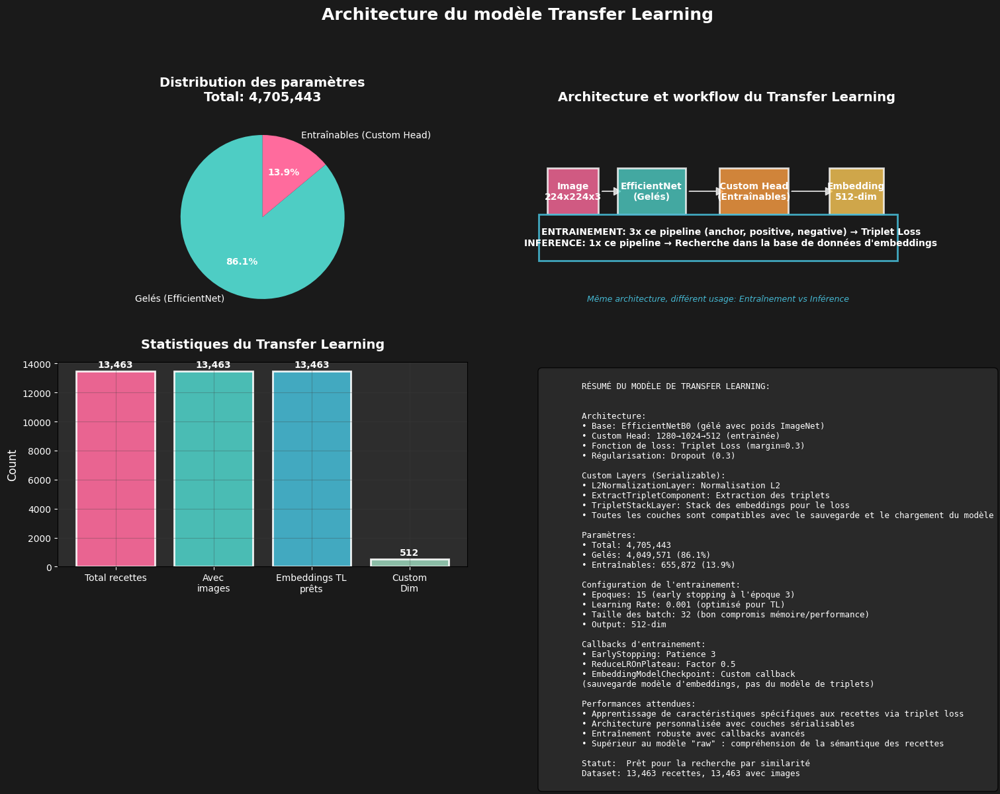


DÉTAILS DU TRANSFER LEARNING:
- EfficientNetB0 gelé: 4,049,571 paramètres
- Custom Head entrainable: 655,872 paramètres
- Total: 4,705,443 paramètres
- Ratio d'entraînement: 13.9%
- Custom Head: 1280→1024→512 (ENTRAÎNABLES)


In [6]:
# Test avec une image aléatoire du dataset
# Si possible, on recharge le système depuis les fichiers sauvegardés => parfait pour préparer le déploiement

import tensorflow as tf
import pickle
import numpy as np
import os
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.metrics.pairwise import cosine_similarity
from tensorflow.keras.layers import Layer

#  COUCHE L2 NORMALIZATION PERSONNALISÉE (SÉRIALISABLE)
class L2NormalizationLayer(Layer):
    """Couche personnalisée pour normalisation L2 - sérialisable"""
    
    def __init__(self, axis=1, **kwargs):
        super(L2NormalizationLayer, self).__init__(**kwargs)
        self.axis = axis
    
    def call(self, inputs):
        return tf.nn.l2_normalize(inputs, axis=self.axis)
    
    def compute_output_shape(self, input_shape):
        return input_shape
    
    def get_config(self):
        config = super(L2NormalizationLayer, self).get_config()
        config.update({'axis': self.axis})
        return config
    
#  COUCHE EXTRACTION TRIPLET PERSONNALISÉE (SÉRIALISABLE)
class ExtractTripletComponent(Layer):
    """Couche pour extraire une composante du triplet"""
    
    def __init__(self, component_index, **kwargs):
        super(ExtractTripletComponent, self).__init__(**kwargs)
        self.component_index = component_index
    
    def call(self, inputs):
        return inputs[:, self.component_index]
    
    def compute_output_shape(self, input_shape):
        # input_shape = (batch_size, 3, height, width, channels)
        return (input_shape[0], input_shape[2], input_shape[3], input_shape[4])
    
    def get_config(self):
        config = super(ExtractTripletComponent, self).get_config()
        config.update({'component_index': self.component_index})
        return config

#  COUCHE STACK TRIPLET PERSONNALISÉE (SÉRIALISABLE)
class TripletStackLayer(Layer):
    """Couche personnalisée pour empiler les embeddings triplet"""
    
    def __init__(self, **kwargs):
        super(TripletStackLayer, self).__init__(**kwargs)
    
    def call(self, inputs):
        # inputs = [anchor_emb, positive_emb, negative_emb]
        return tf.stack(inputs, axis=1)
    
    def compute_output_shape(self, input_shape):
        # input_shape = [(batch_size, embedding_dim), ...]
        batch_size = input_shape[0][0]
        embedding_dim = input_shape[0][1]
        return (batch_size, 3, embedding_dim)
    
    def get_config(self):
        return super(TripletStackLayer, self).get_config()

CONFIG_STANDALONE = {
    'IMG_SIZE': 224,
}

# On essaie de charger le système sauvegardé
print("Chargement du système sauvegardé...")
    
try:
    # Chargement bdd embeddings
    embeddings_db = np.load("./tl/recipe_embeddings_database_tl.npy")
    print(f" Embeddings loaded: {embeddings_db.shape}")
    
    # Chargement métadonnées
    with open("./tl/recipe_embeddings_database_metadata_tl.pkl", 'rb') as f:
        metadata = pickle.load(f)
    print(" Metadata loaded")
    
    # Chargement DataFrame
    recipes_df_path = "./data/recipes_with_images_dataframe.pkl"
    if os.path.exists(recipes_df_path):
        recipes_with_images = pd.read_pickle(recipes_df_path)
        print(f" Recipes DataFrame loaded: {len(recipes_with_images)} recipes")
    else:
        print(" recipes_with_images_dataframe_tl.pkl not found!")
        print(" Please save the DataFrame first using:")
        print("   recipes_with_images.to_pickle('recipes_with_images_dataframe.pkl')")
     
    # Création du système
    retrieval_system_tl = RecipeImageRetrievalTL()
    retrieval_system_tl.embeddings_db = embeddings_db
    retrieval_system_tl.image_paths = metadata['image_paths']
    retrieval_system_tl.image_to_recipe_map = metadata['image_to_recipe_map']
    
    print(f"Système chargé avec {len(embeddings_db):,} embeddings!")
   
except FileNotFoundError as e:
    print(f"Fichier introuvable: {e}")
    print("Veuillez vérifier que ces fichiers existent:")
    print("   - recipe_image_retrieval_model_tl.keras (ou dans le dossier ./models/)")
    print("   - recipe_embeddings_database_tl.npy")
    print("   - recipe_embeddings_database_metadata_tl.pkl")
    print("   - recipes_with_images_dataframe.pkl")
   
except Exception as e:
    print(f" Error loading system: {e}")
    import traceback
    traceback.print_exc()
    
print("\nVisualisation de l'architecture du modèle...")
retrieval_system_tl.visualize_model_architecture()

## 7. Test de recherche sur une image aléatoire du dataset


Test avec une image aléatoire de la base de données...
Test avec l'image: /teamspace/studios/this_studio/.cache/kagglehub/datasets/pes12017000148/food-ingredients-and-recipe-dataset-with-images/versions/1/Food Images/Food Images/brownie-pudding-cake-14408.jpg
Recherche des 3 recette similaires avec le modèle de Transfer Learning...


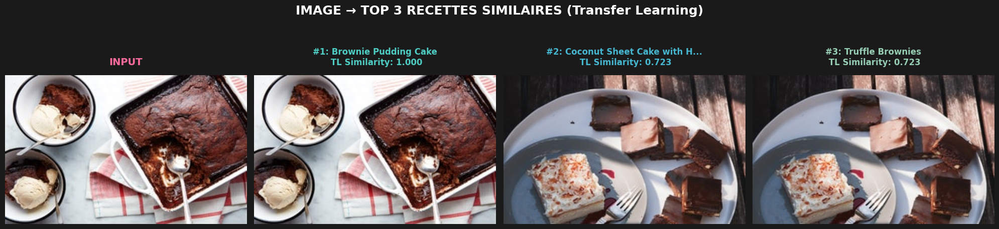


RECETTES SIMILAIRES (Transfer Learning)

RANG #1: 1.0000
Brownie Pudding Cake
------------------------------------------------------------
Ingredients:
['1 cup all-purpose flour', '2/3 cup unsweetened cocoa powder', '3/4 teaspoon double-acting baking powder', '3/4 teaspoon salt', '2 large eggs', '1 cup granulated sugar', '3/4 stick (6 tablespoons) unsalted butter, melted and cooled', '1/2 cup milk', '1 teaspoon vanilla extract', '1/2 cup chopped wa...
------------------------------------------------------------
Instructions:
Preheat the oven to 350°F. Into a bowl sift together the flour, 1/3 cup of the cocoa powder, the baking powder, and the salt. In another bowl whisk together the eggs, the granulates sugar, the butter, the milk, and the vanilla, add the flour mixture, and stir the batter until it is just combined. Stir in the walnuts and spread the batter evenly in an ungreased 8-inch-square baking pan. In a bowl w...

RANG #2: 0.7232
Coconut Sheet Cake with Hibiscus Sauce
--------

In [7]:
print("\nTest avec une image aléatoire de la base de données...")
retrieval_system_tl.test_with_random_image(top_k=3)

## 8. Recherche sur des images inconnues du système

Chargement du système Transfer Learning...
Modèle TL chargé: ./tl/best_embedding_recipe_image_retrieval_model_tl.keras
Système chargé avec 13,463 embeddings!

TEST IMAGE 1.jpg (Transfer Learning)
Recherche des 3 recette similaires avec le modèle de Transfer Learning...


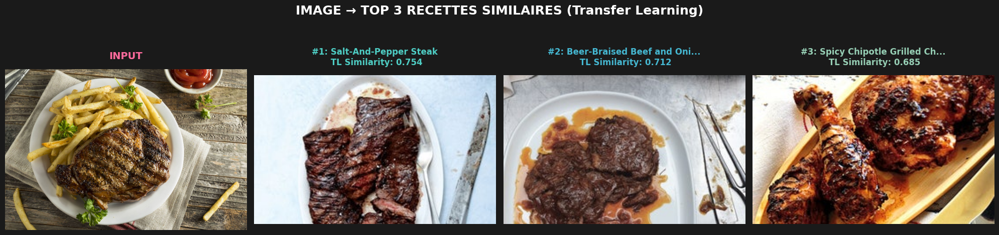


RECETTES SIMILAIRES (Transfer Learning)

RANG #1: 0.7536
Salt-And-Pepper Steak
------------------------------------------------------------
Ingredients:
['1 1/2 pound skirt steak, cut into 4 pieces', 'Salt', 'Pepper']
------------------------------------------------------------
Instructions:
Cut 1 1/2 pound skirt steak into 4 pieces; season with salt and pepper.
Grill over medium-high heat until medium-rare, about 4 minutes per side.
Let rest 5 minutes before thinly slicing against the grain.

RANG #2: 0.7115
Beer-Braised Beef and Onions
------------------------------------------------------------
Ingredients:
['3 pounds onions', '1 (5-pound) boneless beef chuck roast, tied', '2 tablespoons vegetable oil, divided', '2 Turkish bay leaves or 1 California', '2 (12-ounces) bottles pilsner-style beer such as Budweiser', '2 tablespoons red-wine vinegar']
------------------------------------------------------------
Instructions:
Halve onions lengthwise, then slice lengthwise 1/4 inch thick.


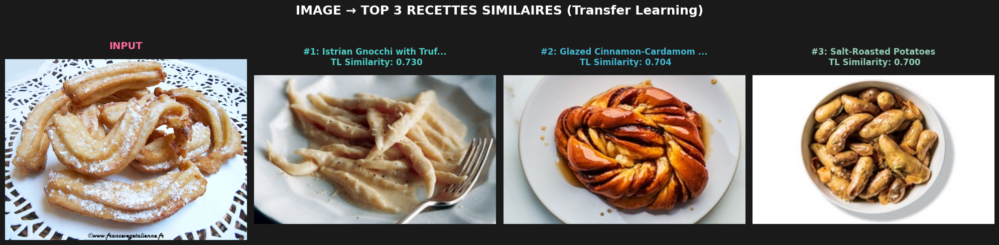


RECETTES SIMILAIRES (Transfer Learning)

RANG #1: 0.7302
Istrian Gnocchi with Truffle Cream
------------------------------------------------------------
Ingredients:
['1 1/2 cups all-purpose flour', '1 large egg', '1 1/2 teaspoons salt', '1 tablespoon extra-virgin olive oil', '1/4 to 1/3 cup water', '2/3 cup heavy cream', '4 teaspoons truffle butter', '1 ounce grated Parmigiano-Reggiano (1/2 cup)', 'grated Parmigiano-Reggiano']
------------------------------------------------------------
Instructions:
Sift flour in a mound on a wooden board or work surface and make a well in center. Add egg, salt, oil, and 1/4 cup water to well and mix with a fork, gathering flour gradually into egg mixture to form a dough. If it seems dry, add water (up to 2 tablespoons). Knead on a lightly floured surface, incorporating just enough flour to keep dough from sticking, until smooth and elastic, 8 to 10 minutes.
...

RANG #2: 0.7042
Glazed Cinnamon-Cardamom Buns
-----------------------------------------

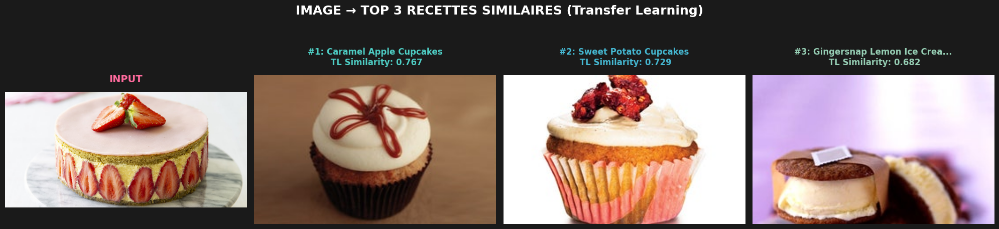


RECETTES SIMILAIRES (Transfer Learning)

RANG #1: 0.7673
Caramel Apple Cupcakes
------------------------------------------------------------
Ingredients:
['2 1/2 cups all-purpose flour', '3 tsp. baking powder', '1 tsp. ground cinnamon', '1/2 tsp. salt', '16 Tbsp. unsalted butter, at room temperature (European style recommended)', '2 cups sugar', '4 large eggs, at room temperature', '1/3 cup hot water', '2 1/2 cups freshly grated apples (4 to 5 medium...
------------------------------------------------------------
Instructions:
Preheat the oven to 350°F. Line a standard cupcake pan with twelve paper baking cups, and a second pan with six baking cups, or grease pans with butter if not using baking cups.
Sift together the flour, baking powder, cinnamon, and salt on a sheet of parchment paper or wax paper and set aside.
Place the butter in the bowl of a stand mixer or in a bowl with a handheld electric mixer. Beat on medium...

RANG #2: 0.7291
Sweet Potato Cupcakes
-----------------------

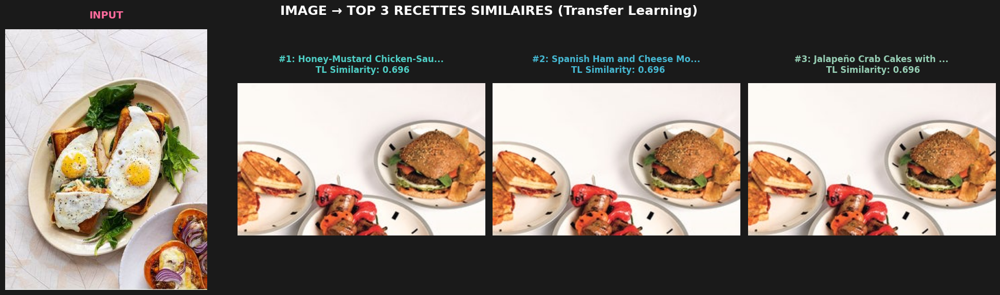


RECETTES SIMILAIRES (Transfer Learning)

RANG #1: 0.6958
Honey-Mustard Chicken-Sausage Kebabs
------------------------------------------------------------
Ingredients:
['6 tablespoons Dijon mustard', '2 tablespoons honey', '1 tablespoon mayonnaise', '4 fully cooked sun-dried-tomato chicken sausages, each cut into 6 pieces', '24 mini bell peppers', 'Olive oil', 'Metal skewers']
------------------------------------------------------------
Instructions:
Prepare barbecue (medium-high heat). Whisk mustard, honey, and mayonnaise in small bowl to blend. Thread 3 sausage pieces alternatively with 3 peppers onto each of 8 skewers and place on baking sheet. Brush with milk; sprinkle with salt and pepper.
Grill skewers until vegetables are lightly charred and crisp-tender and sausage is heated through, turning occasionally and brushing with mustard mixtu...

RANG #2: 0.6958
Spanish Ham and Cheese Monte Cristo Sandwiches
------------------------------------------------------------
Ingredients:
['

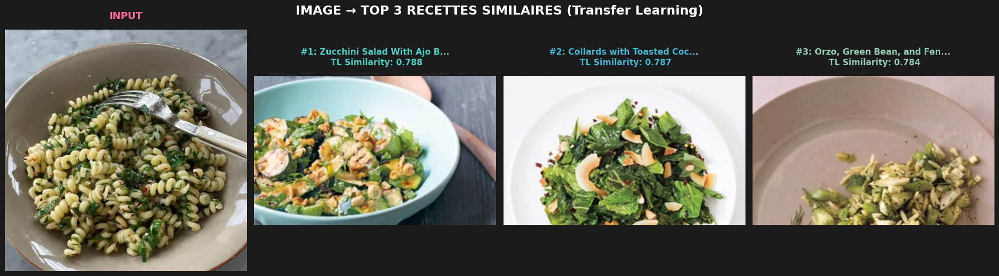


RECETTES SIMILAIRES (Transfer Learning)

RANG #1: 0.7875
Zucchini Salad With Ajo Blanco Dressing & Spiced Nuts
------------------------------------------------------------
Ingredients:
['3 to 4 slices white bread, crusts removed', '3/4 cup blanched almonds, roughly chopped', '1 garlic clove, peeled', '1 teaspoon sherry vinegar', '1 cup extra-virgin olive oil', '1/3 cup ice-cold water', '3 medium zucchinis, cut into random pieces', '1/2 ounce hazelnuts, chopped', '1/2 ounce blanche...
------------------------------------------------------------
Instructions:
For the dressing, first soak the bread in water for 5 minutes. Drain the bread, then place in a blender with the almonds, garlic, vinegar, and 1/2 cup of the olive oil. Gradually add the cold water and blend on high for 30 seconds, or until a smooth purée forms. Add salt to taste, then set aside in a bowl until serving time.
Preheat the oven to 350°F
On the stove, heat a ridged grill pan or grill ...

RANG #2: 0.7872
Collards with 

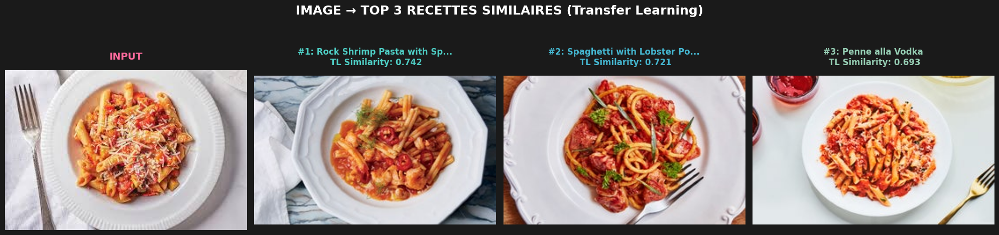


RECETTES SIMILAIRES (Transfer Learning)

RANG #1: 0.7425
Rock Shrimp Pasta with Spicy Tomato Sauce
------------------------------------------------------------
Ingredients:
['1 (28-ounce) can whole peeled tomatoes, preferably San Marzano, drained', '1/3 cup olive oil, plus more for drizzling', '1/2 medium fennel bulb, fronds reserved, core removed, bulb thinly sliced', '8 garlic cloves, smashed', '1 Fresno chile, very thinly sliced, divided', '1/4 cup dry white wine', ...
------------------------------------------------------------
Instructions:
Set a fine-mesh sieve over a medium bowl. Working over sieve, squeeze tomatoes to release juices and break up flesh. Let tomatoes drain in sieve, collecting juices in bowl, until ready to use.
Heat 1/3 cup oil in a large Dutch oven or other heavy pot over medium. Cook fennel, garlic, and half of chile, stirring often, until garlic is golden and fennel is starting to brown around the edges, 5–8 min...

RANG #2: 0.7211
Spaghetti with Lobster Pom

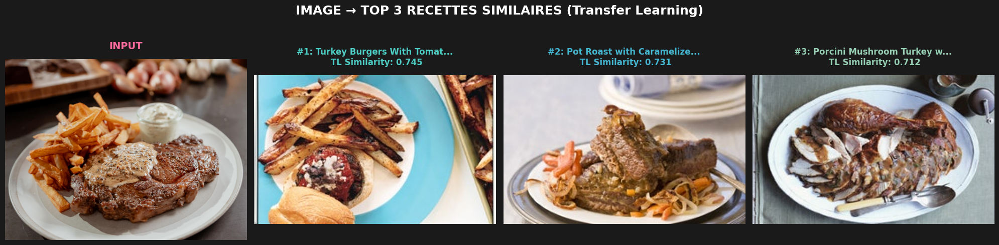


RECETTES SIMILAIRES (Transfer Learning)

RANG #1: 0.7446
Turkey Burgers With Tomato Jam, Olives, and Feta
------------------------------------------------------------
Ingredients:
['1 pound ground turkey', '2/3 cup finely chopped red onion', '1/3 cup (about 2 ounces) crumbled feta cheese plus additional for topping', '3 tablespoons coarsely chopped pitted Kalamata olives (about 6), plus additional for topping', '1 1/2 teaspoons olive oil plus additional for brushing', '1 smal...
------------------------------------------------------------
Instructions:
Prepare barbecue (medium-high heat). Brush grill rack with oil.
Gently mix turkey, onion, 1/3 cup feta, 3 tablespoons chopped olives, 1 1/2 teaspoons olive oil, garlic, rosemary, generous 1/2 teaspoon coarse salt, and generous 1/2 teaspoon pepper in medium bowl. Form into 4 patties, each about 1 inch thick. Brush with oil and sprinkle with salt and pepper.
Grill burgers until charred on both sides...

RANG #2: 0.7313
Pot Roast with Cara

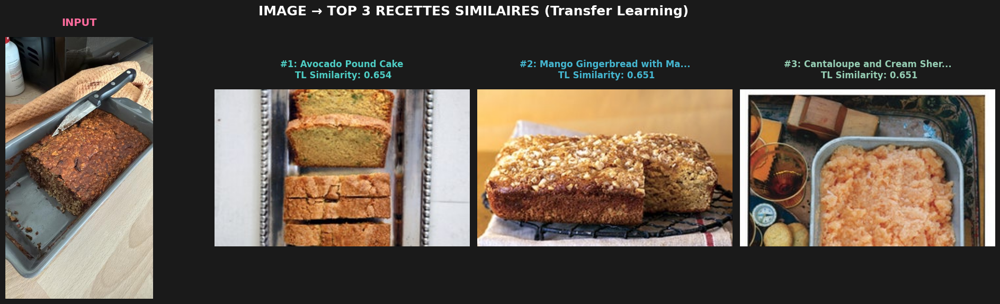


RECETTES SIMILAIRES (Transfer Learning)

RANG #1: 0.6542
Avocado Pound Cake
------------------------------------------------------------
Ingredients:
['3 cups all-purpose flour', '1/2 cup yellow cornmeal', '1/2 teaspoon salt', '1 1/2 teaspoons baking powder', '1 1/2 teaspoons baking soda', '3/4 cup (1 1/2 sticks) unsalted butter, softened', '3 cups granulated sugar', '1 cup plus 2 tablespoons ripe mashed avocados', '4 large eggs', '2 teaspoons pu...
------------------------------------------------------------
Instructions:
Place a rack in the center and upper third of the oven and preheat to 350 degrees F. Grease and flour two 9x5-inch loaf pans and set aside.
In a medium bowl, whisk together flour, cornmeal, salt, baking powder, and baking soda. Set aside.
In the bowl of an electric stand mixer fitted with a paddle attachment, beat butter and sugar on medium speed until light and fluffy, 3 to 5 minutes. Add avocado...

RANG #2: 0.6514
Mango Gingerbread with Macadamia Streusel
-------

In [8]:
import tensorflow as tf
import numpy as np
import os
import pickle
import pandas as pd

# Custom layers pour TL (nécessaires pour le chargement)
class L2NormalizationLayer(tf.keras.layers.Layer):
    def __init__(self, axis=1, **kwargs):
        super(L2NormalizationLayer, self).__init__(**kwargs)
        self.axis = axis
    
    def call(self, inputs):
        return tf.nn.l2_normalize(inputs, axis=self.axis)
    
    def get_config(self):
        config = super(L2NormalizationLayer, self).get_config()
        config.update({'axis': self.axis})
        return config

class ExtractTripletComponent(tf.keras.layers.Layer):
    def __init__(self, component_index, **kwargs):
        super(ExtractTripletComponent, self).__init__(**kwargs)
        self.component_index = component_index
    
    def call(self, inputs):
        return inputs[:, self.component_index]
    
    def get_config(self):
        config = super(ExtractTripletComponent, self).get_config()
        config.update({'component_index': self.component_index})
        return config

class TripletStackLayer(tf.keras.layers.Layer):
    def __init__(self, **kwargs):
        super(TripletStackLayer, self).__init__(**kwargs)
    
    def call(self, inputs):
        return tf.stack(inputs, axis=1)
    
    def get_config(self):
        return super(TripletStackLayer, self).get_config()

print("Chargement du système Transfer Learning...")

try:
    # Chargement bdd embeddings
    embeddings_db = np.load("./tl/recipe_embeddings_database_tl.npy")
    
    # Chargement métadonnées
    with open("./tl/recipe_embeddings_database_metadata_tl.pkl", 'rb') as f:
        metadata = pickle.load(f)
    
    # Chargement DataFrame
    recipes_with_images = pd.read_pickle("./data/recipes_with_images_dataframe.pkl")
    
    # Création du système
    retrieval_system_tl = RecipeImageRetrievalTL()
    retrieval_system_tl.embeddings_db = embeddings_db
    retrieval_system_tl.image_paths = metadata['image_paths']
    retrieval_system_tl.image_to_recipe_map = metadata['image_to_recipe_map']
    
    print(f"Système chargé avec {len(embeddings_db):,} embeddings!")
    
except FileNotFoundError:
    print("Aucun système sauvegardé trouvé.")
    retrieval_system_tl = None
except Exception as e:
    print(f"Erreur: {e}")
    retrieval_system_tl = None

if retrieval_system_tl and retrieval_system_tl.embeddings_db is not None:
    # Test sur les images 1.jpg à 8.jpg
    for i in range(1, 9):
        test_image = f"./test_recipes/{i}.jpg"
        
        if os.path.exists(test_image):
            print(f"\n{'='*50}")
            print(f"TEST IMAGE {i}.jpg (Transfer Learning)")
            print(f"{'='*50}")
            
            results = retrieval_system_tl.search_similar_recipes(test_image, top_k=3)
            if results:
                retrieval_system_tl.display_results(test_image, results)
            else:
                print("Aucun résultat trouvé")
        else:
            print(f"Image {i}.jpg introuvable")
    
else:
    print("Système non disponible")